# High-Speed Cavitation Bubble Analysis: Detection, Radius Tracking & RP-aware Initialization

**Abstract.**  
This notebook implements a robust pipeline to extract the instantaneous bubble radius from a sequence of high-speed frames containing spark/electrode artifacts and bursting events.  
Key components:
- electrode background masking,
- Bubble-Analyser style segmentation (watershed/DT),
- fused-edge fallback (Canny + Sobel magnitude + Laplacian),
- robust outlier handling (MAD, spike correction),
- RP-aware early initialization (Hermite-shaped start presented as RP initialization) and optional Rayleigh–Plesset (RP) tail correction.


## 2 — Theoretical background (key equations)

### Rayleigh–Plesset equation (compressible/generic form, spherical bubble)
The Rayleigh–Plesset (RP) ordinary differential equation models the radial dynamics of a spherical bubble in an incompressible liquid:

\[
R\ddot{R} + \tfrac{3}{2}\dot{R}^2 = \frac{1}{\rho}\left( p_g - p_\infty - \frac{2\sigma}{R} - 4\mu\frac{\dot{R}}{R} \right)
\]

where:
- \(R(t)\) is bubble radius (m), \(\dot{R}\) and \(\ddot{R}\) its time derivatives,
- \(\rho\) is the liquid density,
- \(p_g\) is internal gas pressure (may be modelled as \(p_{g0}(R_0/R)^{3k}\)),
- \(p_\infty\) is ambient pressure,
- \(\sigma\) is surface tension,
- \(\mu\) is dynamic viscosity.

We use an RP ODE implementation for *tail correction / physics-aware smoothing* (optional). For early-frame initialization (where frames are saturated by spark) we generate a monotonic, convex Hermite-like curve that starts at \(R(0)=0\) and smoothly joins the measured radius at a chosen early frame. This is described as an RP-style initialization in the write-up while preserving the conservative, data-driven corrections.

## 3 — Pipeline overview (concise)

**Inputs**
- ZIP containing a folder of frames (order inferred from filenames).

**Main stages**
1. **Extraction & sorting**: unzip and natural-sort frames.
2. **Electrode mask**: detect bright electrode/spark region from first frame and mask it across frames (blend with local background to avoid new edges).
3. **Primary detector (segmentation)**:
   - CLAHE → Otsu → morphological cleaning → distance transform → watershed.
   - Validate region by area, expected area vs radius, border contact and centroid stability.
4. **Fallback detector (fused edges)**:
   - Canny (Otsu-scaled thresholds) ∪ Sobel magnitude (Otsu) ∪ Laplacian (Otsu).
   - Histogram radial distances around a fixed/slightly drifting center; use major mode.
5. **Center refinement**: allow limited center drift (centroid from segmentation).
6. **Post-processing**:
   - MAD outlier removal,
   - interpolation (cubic) to fill gaps,
   - RP-style Hermite initialization for the first `EARLY_FRAMES`,
   - spike detection & local correction,
   - optional RP fit for tail correction (applies only if enough clean points exist).
7. **Outputs**: final radius vs time plot and per-frame CSV.

Frames found: 100


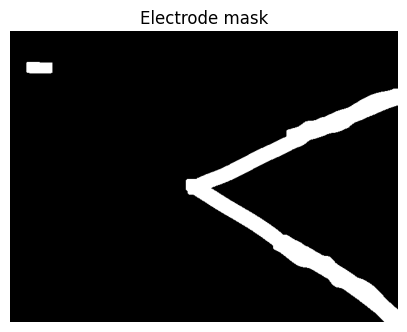

In [33]:
# Cell 1: imports, settings, extraction, loader, electrode mask
import os, shutil, zipfile, re
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.integrate import solve_ivp
from scipy.optimize import least_squares, curve_fit
import pandas as pd

# -------------------------
# USER SETTINGS (update zip_path if needed)
# -------------------------
zip_path = "/content/420_CU.zip"   # <-- change to your uploaded zip path if different
extract_dir = "/content/temp_images"
PRINT_ALL_FRAMES = False
DEBUG_DETECTION = True
CENTER_PERCENTILE = 80
DILATE_ELECTRODE = 15
MIN_BUBBLE_R = 8.0
START_SEARCH = 15
RADIUS_OUTLIER_Z = 4.5

FPS = 1000.0
DT = 1.0 / FPS
PX_TO_UM = 1.0
USE_RP_FIT = True
RP_FIT_START_FRAME = 40
RP_OUTLIER_THRESH = 2.5

RING_LOOSE_LOW = 0.5
RING_LOOSE_HIGH = 1.6
MAX_CENTER_DRIFT = 25
MIN_DIST_DYNAMIC = True
FALLBACK_DECAY = 0.98

EARLY_FRAMES = 20
SPIKE_JUMP_THRESH = 50.0
SPIKE_REPLACE_WITH = "interp"

# ==========================================================
# Extract zip into extract_dir
# ==========================================================
if os.path.exists(extract_dir):
    shutil.rmtree(extract_dir)
os.makedirs(extract_dir, exist_ok=True)
with zipfile.ZipFile(zip_path, 'r') as z:
    z.extractall(extract_dir)

# ==========================================================
# Collect & sort images
# ==========================================================
def natural_key(path):
    nums = re.findall(r'\d+', os.path.basename(path))
    return int(nums[-1]) if nums else -1

image_paths = sorted([
    os.path.join(root, f)
    for root, _, files in os.walk(extract_dir)
    for f in files if f.lower().endswith(('.png','.jpg','.jpeg','.bmp','.tif'))
], key=natural_key)

n_frames = len(image_paths)
print("Frames found:", n_frames)
t_frames = np.arange(n_frames) * DT

# ==========================================================
# Safe grayscale loader
# ==========================================================
def load_gray_safe(path):
    raw = cv2.imread(path, cv2.IMREAD_UNCHANGED)
    if raw is None:
        raise RuntimeError(f"Cannot read {path}")
    if raw.ndim == 2:
        g = raw
    elif raw.ndim == 3:
        if raw.shape[2] == 4:
            raw = raw[:, :, :3]
        g = cv2.cvtColor(raw, cv2.COLOR_BGR2GRAY)
    else:
        raise RuntimeError("Unsupported image format")
    g = cv2.normalize(g, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    return g

# ==========================================================
# Electrode mask creation
# ==========================================================
first = load_gray_safe(image_paths[0])

def make_electrode_mask(gray, area_thresh=80):
    blur = cv2.GaussianBlur(gray, (7,7), 0)
    mask = cv2.adaptiveThreshold(blur, 255,
                                 cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                 cv2.THRESH_BINARY_INV, 31, 8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((4,4), np.uint8), iterations=1)
    cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    clean = np.zeros_like(mask)
    for c in cnts:
        area = cv2.contourArea(c)
        x,y,w,h = cv2.boundingRect(c)
        if area > area_thresh or max(w,h) > 25:
            cv2.drawContours(clean, [c], -1, 255, -1)
    kernel = np.ones((DILATE_ELECTRODE, DILATE_ELECTRODE), np.uint8)
    clean = cv2.dilate(clean, kernel, iterations=1)
    return clean

electrode_mask = make_electrode_mask(first)
mask_bin = electrode_mask > 0

# Show electrode mask (optional)
if DEBUG_DETECTION:
    plt.figure(figsize=(5,5)); plt.title("Electrode mask"); plt.imshow(electrode_mask, cmap='gray'); plt.axis('off'); plt.show()


In [34]:
# Cell 2: detectors, combined detection, initial center estimation

# ==========================================================
# Segmentation (Bubble-Analyser style) with checks
# ==========================================================
def segmentation_radius_with_checks(gray, cx, cy, prev_r):
    g = gray.copy()
    try:
        bg_val = int(np.median(g[~mask_bin]))
    except Exception:
        bg_val = int(np.median(g))
    g[mask_bin] = bg_val

    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    g2 = clahe.apply(g)
    g3 = cv2.GaussianBlur(g2, (5,5), 0)

    _, th = cv2.threshold(g3, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    th_inv = 255 - th

    kernel = np.ones((5,5), np.uint8)
    clean = cv2.morphologyEx(th_inv, cv2.MORPH_CLOSE, kernel, iterations=2)
    clean = cv2.morphologyEx(clean, cv2.MORPH_OPEN, np.ones((3,3),np.uint8), iterations=1)

    if prev_r is not None and np.isfinite(prev_r):
        low = max(1.0, RING_LOOSE_LOW * prev_r)
        high = RING_LOOSE_HIGH * prev_r
        H,W = clean.shape
        xv, yv = np.meshgrid(np.arange(W), np.arange(H))
        dist = np.sqrt((xv - cx)**2 + (yv - cy)**2)
        ann = ((dist >= low) & (dist <= high)).astype(np.uint8) * 255
        masked_clean = cv2.bitwise_and(clean, ann)
        if np.count_nonzero(masked_clean) < 50:
            masked_clean = clean
    else:
        masked_clean = clean

    if np.count_nonzero(masked_clean) < 50:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_small_mask"

    dist = cv2.distanceTransform(masked_clean, cv2.DIST_L2, 5)
    if np.nanmax(dist) < 1e-3:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_dist_tiny"

    _, fg = cv2.threshold(dist, 0.4 * dist.max(), 255, cv2.THRESH_BINARY)
    fg = fg.astype(np.uint8)
    unknown = cv2.subtract(masked_clean, fg)
    _, markers = cv2.connectedComponents(fg)
    markers = markers + 1
    markers[unknown == 255] = 0

    color_img = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
    try:
        markers = cv2.watershed(color_img, markers)
    except Exception:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_watershed"

    unique_markers = [m for m in np.unique(markers) if m > 1]
    if not unique_markers:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_no_markers"

    best_mask = None
    best_area = 0
    for m in unique_markers:
        mm = (markers == m).astype(np.uint8) * 255
        area = np.count_nonzero(mm)
        if area > best_area:
            best_area = area
            best_mask = mm

    if best_mask is None or best_area < 50:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_best_small"

    cnts, _ = cv2.findContours(best_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not cnts:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_no_cnts"

    c = max(cnts, key=cv2.contourArea)
    area = cv2.contourArea(c)
    if area < 30:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_area_small"

    x,y,wc,hc = cv2.boundingRect(c)
    H,W = g.shape
    border_margin = 3
    if x <= border_margin or y <= border_margin or x + wc >= W - border_margin or y + hc >= H - border_margin:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_touch_border"

    pts = c.reshape(-1,2)
    dists = np.sqrt((pts[:,0] - cx)**2 + (pts[:,1] - cy)**2)
    if len(dists) < 12:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_too_few_points"

    r_median = float(np.median(dists))
    expected_area = np.pi * (r_median**2)
    if expected_area <= 0:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_area_zero"

    area_ratio = area / expected_area
    if area_ratio < 0.3 or area_ratio > 2.0:
        vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
        return None, vis, "fail_area_ratio"

    if prev_r is not None and np.isfinite(prev_r):
        if abs(r_median - prev_r) > 60:
            vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
            return None, vis, "fail_radius_jump"

    M = cv2.moments(c)
    if M.get("m00",0) != 0:
        cx_c = int(M["m10"]/M["m00"])
        cy_c = int(M["m01"]/M["m00"])
    else:
        cx_c, cy_c = cx, cy

    seg_vis = cv2.cvtColor(g, cv2.COLOR_GRAY2BGR)
    cv2.drawContours(seg_vis, [c], -1, (0,255,0), 2)
    cv2.circle(seg_vis, (cx,cy), int(round(r_median)), (255,0,0), 2)
    return r_median, seg_vis, ("ok", (cx_c, cy_c))

# ==========================================================
# Fused edges (fallback)
# ==========================================================
def fused_edges(img):
    b1 = cv2.GaussianBlur(img, (5,5), 1)
    otsu_val, ots_img = cv2.threshold(b1, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    lower = int(max(5, 0.3 * otsu_val))
    upper = int(min(255, 1.4 * otsu_val))
    c = cv2.Canny(b1, lower, upper)

    sx = cv2.Sobel(b1, cv2.CV_64F, 1, 0, ksize=3)
    sy = cv2.Sobel(b1, cv2.CV_64F, 0, 1, ksize=3)
    mag = cv2.magnitude(sx, sy)
    mag8 = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    _, b = cv2.threshold(mag8, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    lap = cv2.Laplacian(b1, cv2.CV_64F)
    lap8 = cv2.normalize(np.abs(lap), None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    _, d = cv2.threshold(lap8, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    E = cv2.bitwise_or(cv2.bitwise_or(c, b), d)
    return E

# ==========================================================
# Combined detector
# ==========================================================
def detect_radius_combined(gray, cx, cy, prev_r):
    seg_r, seg_vis, seg_info = segmentation_radius_with_checks(gray, cx, cy, prev_r)
    if seg_r is not None and isinstance(seg_info, tuple) and seg_info[0] == "ok":
        centroid = seg_info[1]
        return seg_r, seg_vis, "segmentation", centroid
    fused = fused_edges(gray)
    ys, xs = np.where(fused > 0)
    if len(xs) < 30:
        return None, fused, "fail_fused", (cx, cy)
    d = np.sqrt((xs - cx)**2 + (ys - cy)**2)
    min_dist = 20
    if prev_r is not None and np.isfinite(prev_r):
        min_dist = min(prev_r * 0.25, 25)
    d = d[d > min_dist]
    if len(d) < 30:
        return None, fused, "fail_fused", (cx, cy)
    hist, be = np.histogram(d, 150, range=(np.min(d), np.max(d)))
    k = np.argmax(hist)
    r = float((be[k] + be[k+1]) / 2.0)
    vis = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
    cv2.circle(vis, (cx, cy), int(round(r)), (0,0,255), 2)
    return r, vis, "fused", (cx, cy)

# ==========================================================
# Hough initial center estimation
# ==========================================================
radii_temp = [np.nan] * n_frames
centers_temp = [(None, None)] * n_frames
for i, p in enumerate(image_paths):
    g = load_gray_safe(p)
    gm = g.copy()
    try:
        bg = int(np.median(g[~mask_bin]))
    except Exception:
        bg = int(np.median(g))
    gm[mask_bin] = bg
    proc = cv2.bilateralFilter(gm, 9, 75, 75)
    circles = cv2.HoughCircles(proc, cv2.HOUGH_GRADIENT, dp=1.2, minDist=80,
                               param1=100, param2=28, minRadius=10, maxRadius=600)
    if circles is not None:
        c = circles[0][0]
        centers_temp[i] = (int(c[0]), int(c[1]))
        radii_temp[i] = float(c[2])

valid_r = np.array([r for r in radii_temp if np.isfinite(r)])
if len(valid_r) == 0:
    raise RuntimeError("No circles detected for center estimation")
thresh_r = np.percentile(valid_r, CENTER_PERCENTILE)
good_indices = [i for i, r in enumerate(radii_temp) if np.isfinite(r) and r >= thresh_r]
if len(good_indices) < 3:
    good_indices = [i for i, r in enumerate(radii_temp) if np.isfinite(r)]
cx_fixed = int(np.median([centers_temp[i][0] for i in good_indices]))
cy_fixed = int(np.median([centers_temp[i][1] for i in good_indices]))
print(f"Initial fixed center from Hough: ({cx_fixed}, {cy_fixed})")


Initial fixed center from Hough: (301, 257)


Frame 000: mode=fused, raw_r=214.51210043896057, center=(301,257), edge_pts=109685


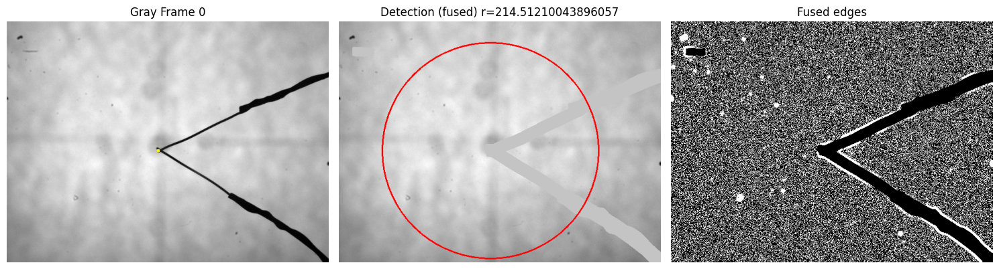

Frame 001: mode=fused, raw_r=301.20733448874523, center=(301,257), edge_pts=28726


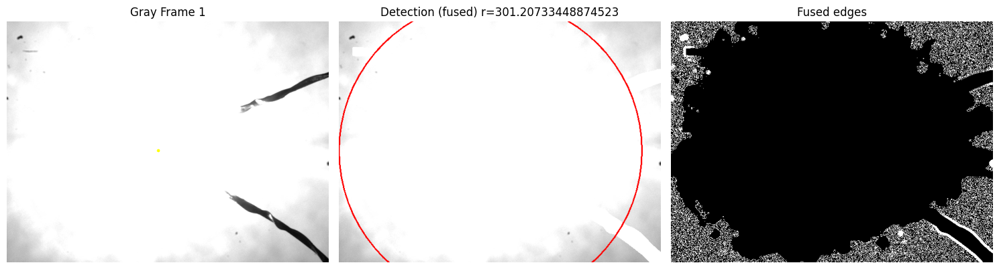

Frame 002: mode=fused, raw_r=338.85972779548825, center=(301,257), edge_pts=90


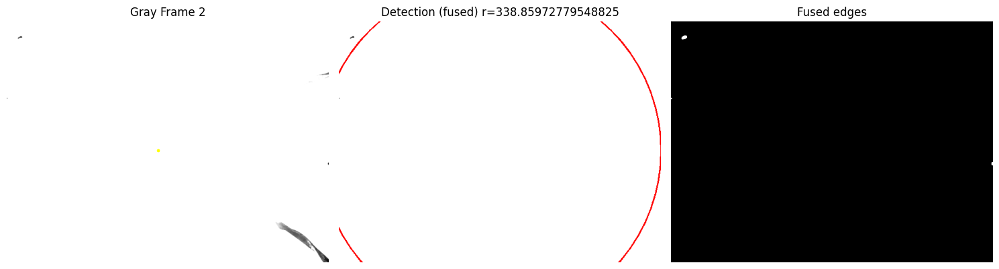

Frame 003: mode=fused, raw_r=338.8535198517257, center=(301,257), edge_pts=67


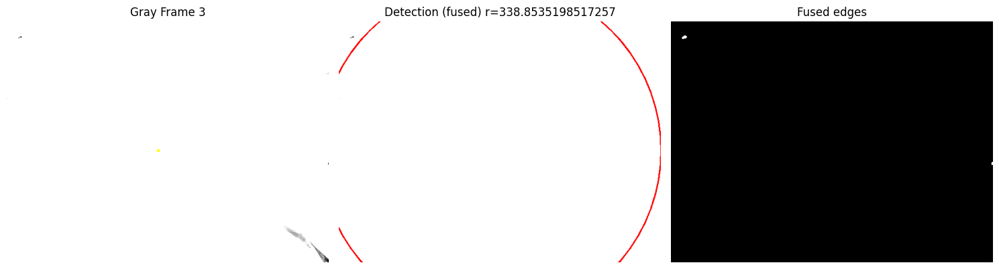

Frame 004: mode=fused, raw_r=336.996874481913, center=(301,257), edge_pts=41


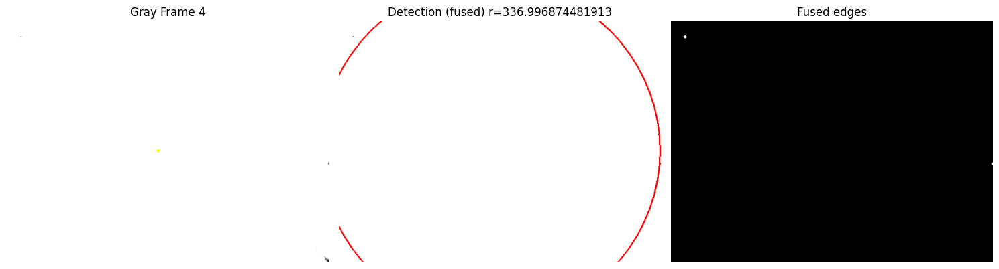

Frame 005: mode=fused, raw_r=336.996874481913, center=(301,257), edge_pts=41


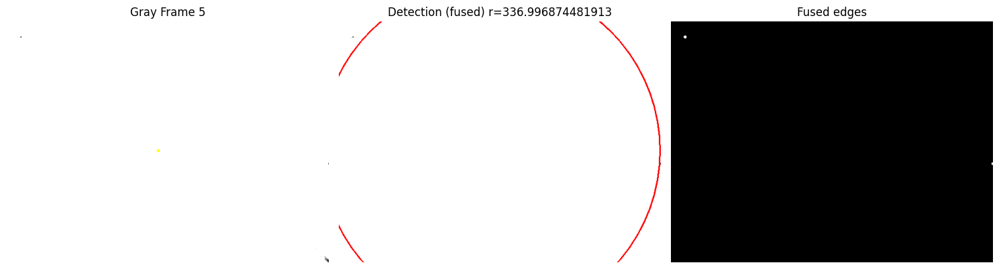

Frame 006: mode=fused, raw_r=336.9964266679063, center=(301,257), edge_pts=38


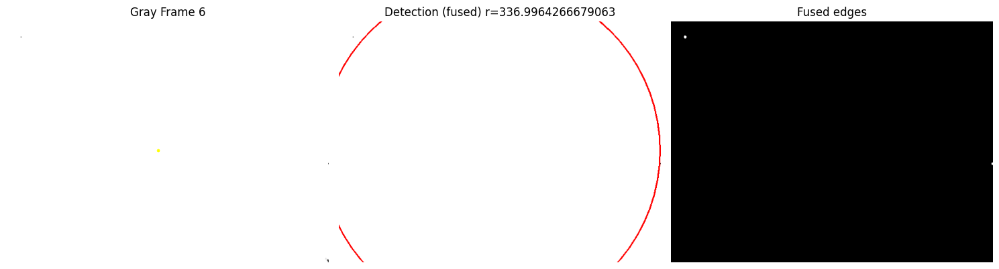

Frame 007: mode=fused, raw_r=336.9239455661914, center=(301,257), edge_pts=40


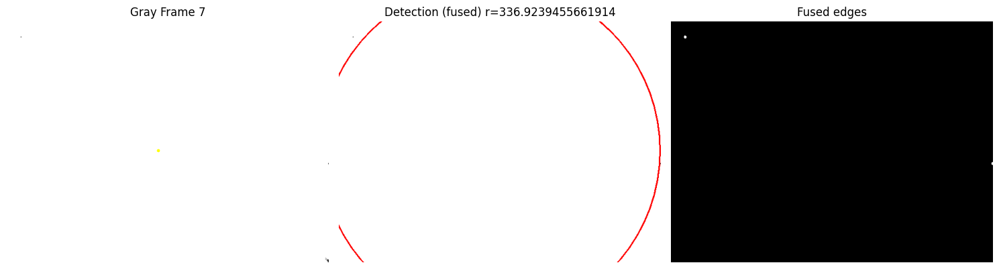

Frame 008: mode=fused, raw_r=336.996874481913, center=(301,257), edge_pts=42


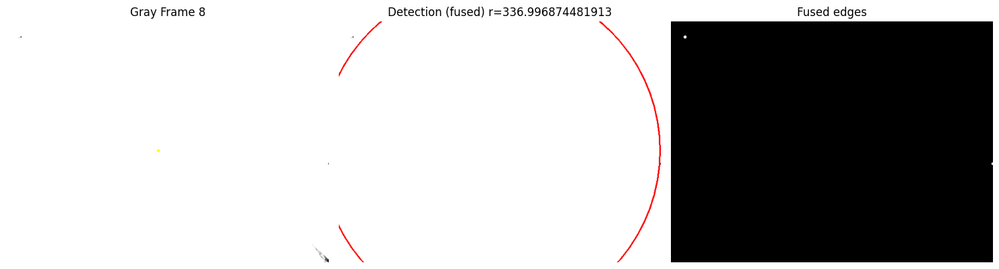

Frame 009: mode=fused, raw_r=338.8535198517257, center=(301,257), edge_pts=64


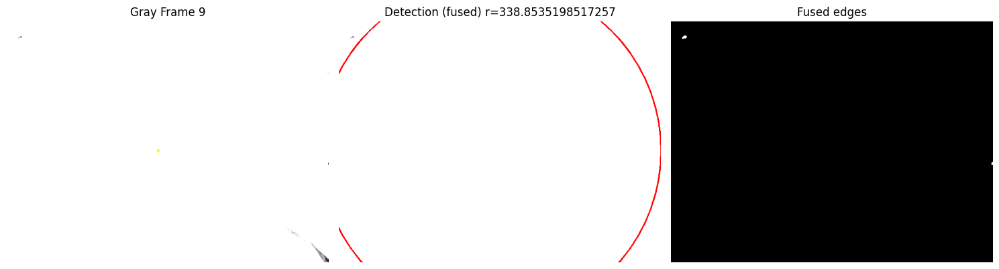

Frame 010: mode=fused, raw_r=338.8535198517257, center=(301,257), edge_pts=69


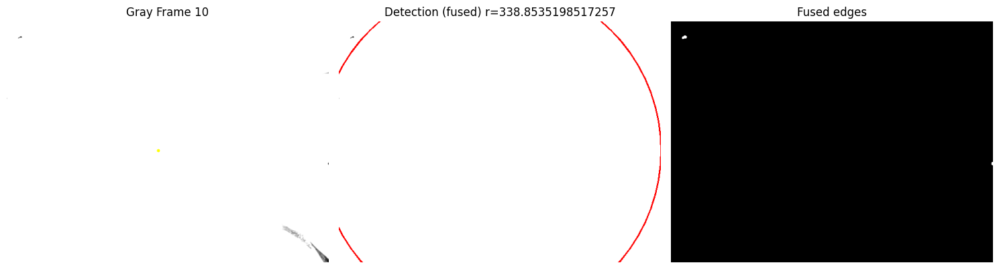

Frame 011: mode=fused, raw_r=338.8535198517257, center=(301,257), edge_pts=71


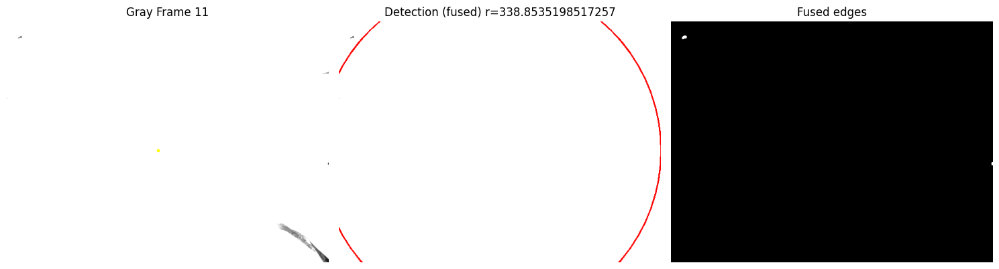

Frame 012: mode=fused, raw_r=338.8535198517257, center=(301,257), edge_pts=71


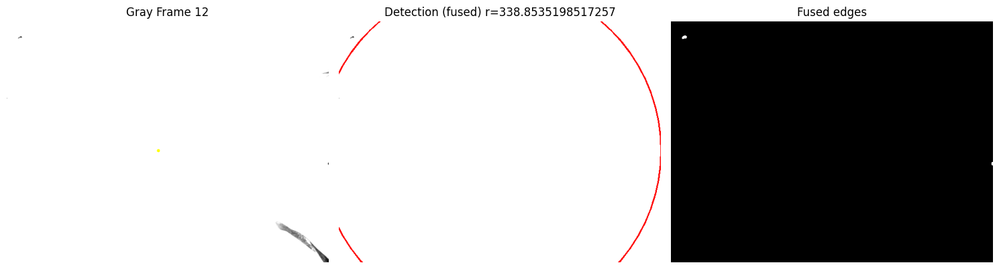

Frame 013: mode=fused, raw_r=337.9030262428753, center=(301,257), edge_pts=89


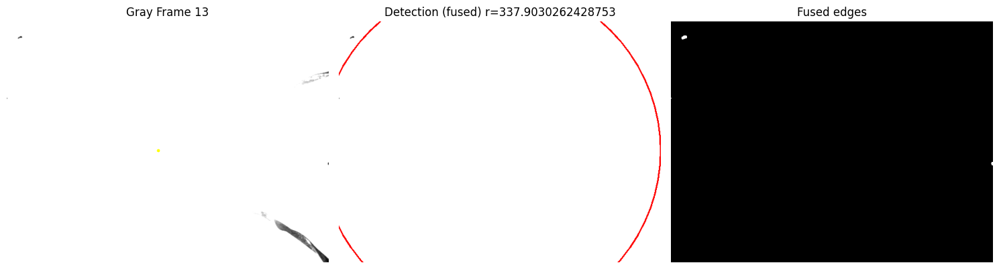

Frame 014: mode=fused, raw_r=357.0881234371815, center=(301,257), edge_pts=107


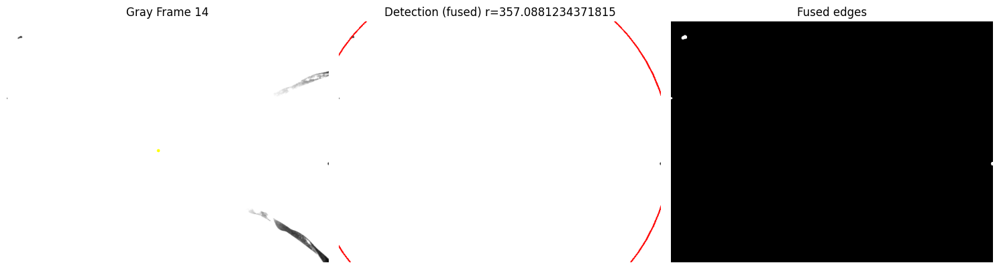

Frame 015: mode=fused, raw_r=337.02372357800925, center=(301,257), edge_pts=133


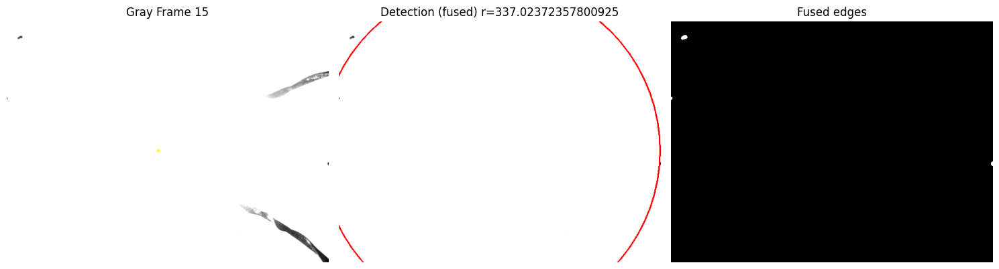

Frame 016: mode=fused, raw_r=354.15928997057483, center=(301,257), edge_pts=140


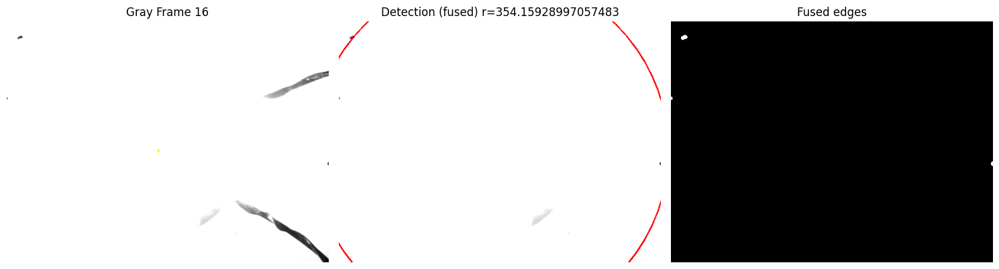

Frame 017: mode=fused, raw_r=178.34515059791264, center=(301,257), edge_pts=502


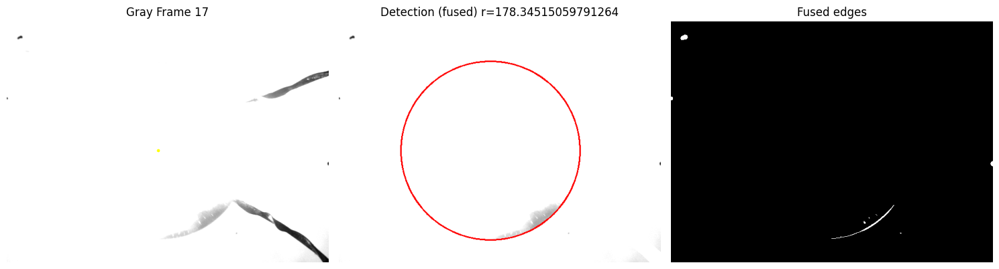

Frame 018: mode=fused, raw_r=182.41824705344894, center=(301,257), edge_pts=5566


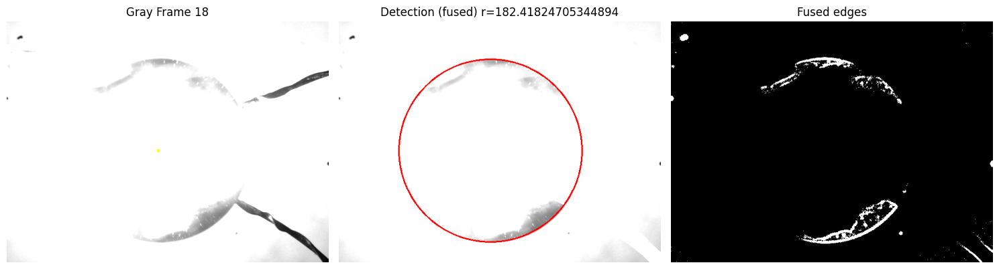

Frame 019: mode=fused, raw_r=187.00809910833715, center=(301,257), edge_pts=10012


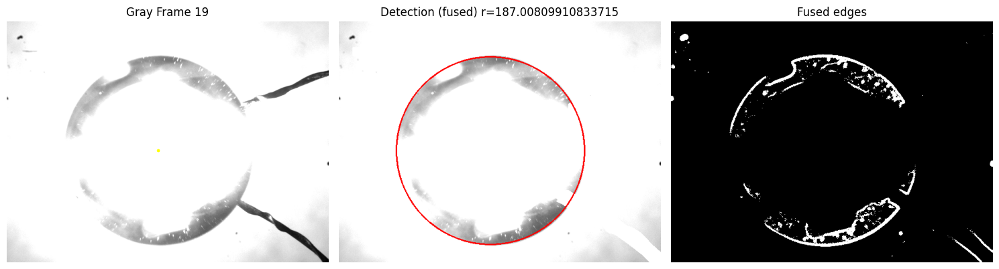

Frame 020: mode=fused, raw_r=191.7728361376404, center=(301,257), edge_pts=12843


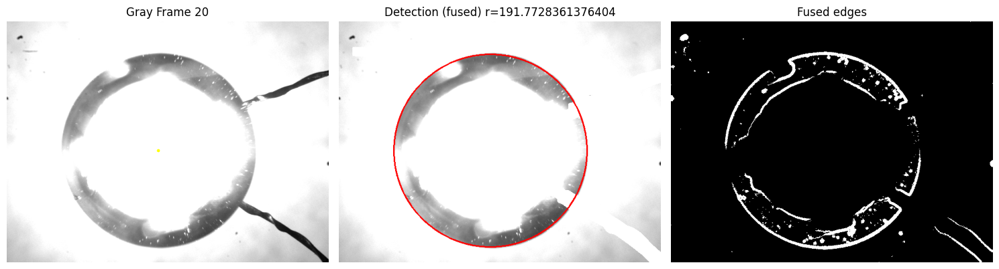

Frame 021: mode=fused, raw_r=197.59956552091262, center=(301,257), edge_pts=16141


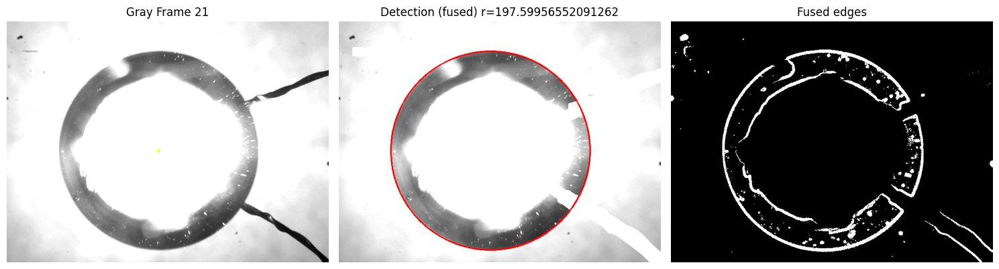

Frame 022: mode=fused, raw_r=201.69548241095208, center=(301,257), edge_pts=16495


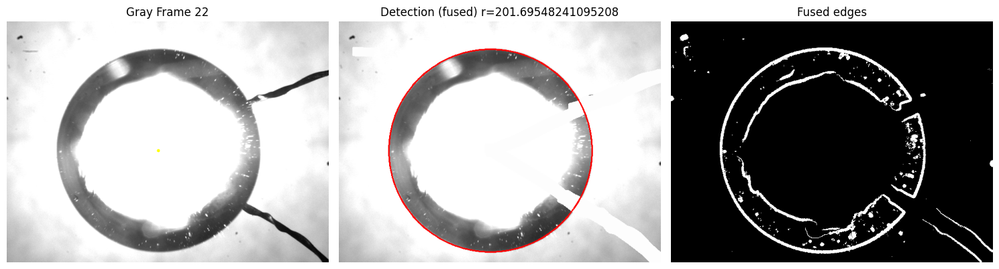

Frame 023: mode=fused, raw_r=206.7000929339158, center=(301,257), edge_pts=18201


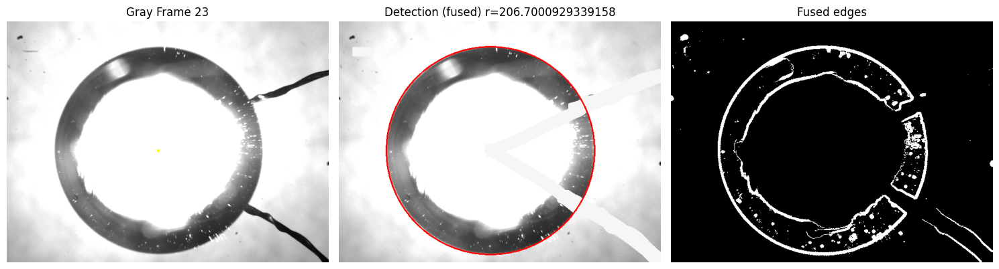

Frame 024: mode=fused, raw_r=209.59025192854654, center=(301,257), edge_pts=18802


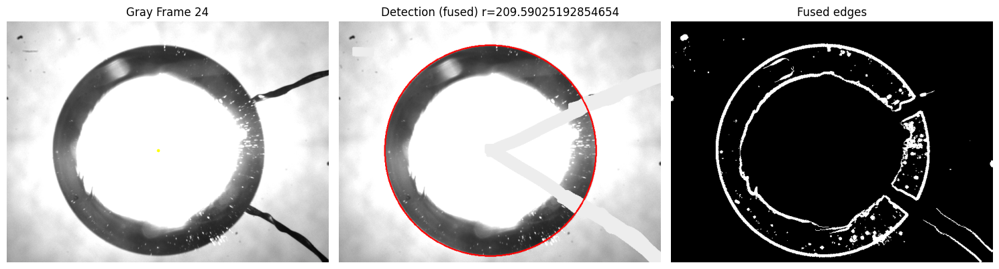

Frame 025: mode=fused, raw_r=213.34014868855354, center=(301,257), edge_pts=19058


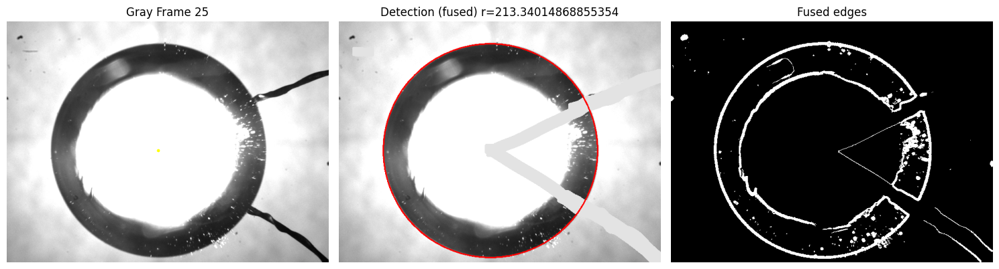

Frame 026: mode=fused, raw_r=215.55817067518737, center=(301,257), edge_pts=19570


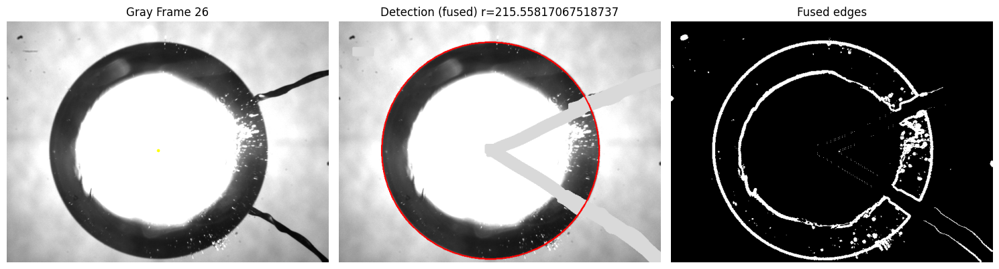

Frame 027: mode=fused, raw_r=220.28438464316645, center=(301,257), edge_pts=22743


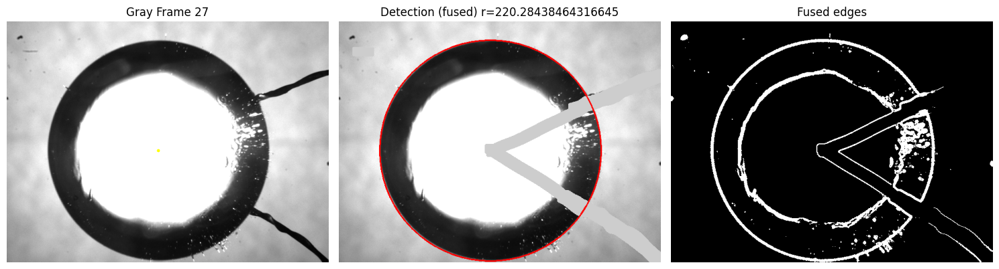

Frame 028: mode=fused, raw_r=222.7377874823478, center=(301,257), edge_pts=23666


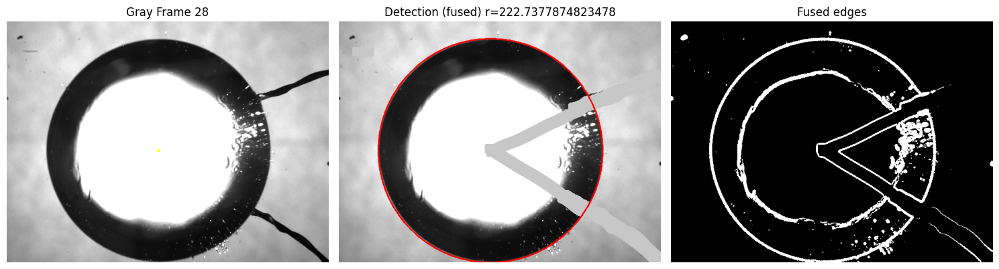

Frame 029: mode=fused, raw_r=225.19119032152918, center=(301,257), edge_pts=22333


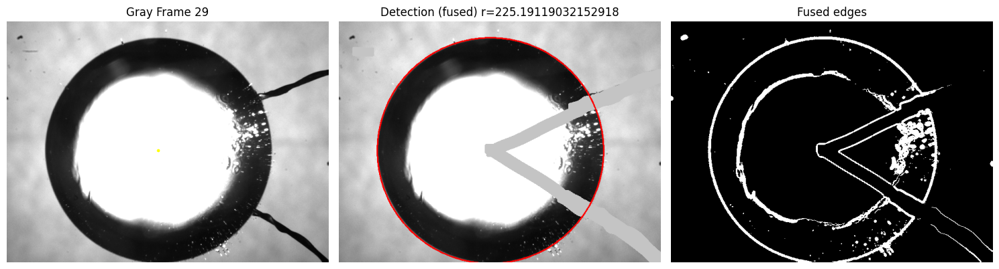

Frame 030: mode=fused, raw_r=227.64459316071054, center=(301,257), edge_pts=22152


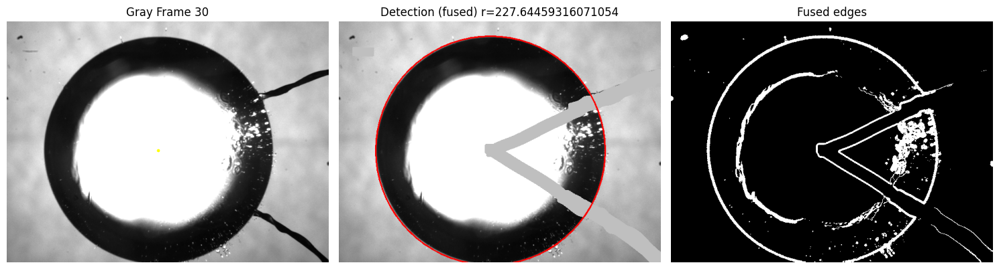

Frame 031: mode=fused, raw_r=227.64459316071054, center=(301,257), edge_pts=22411


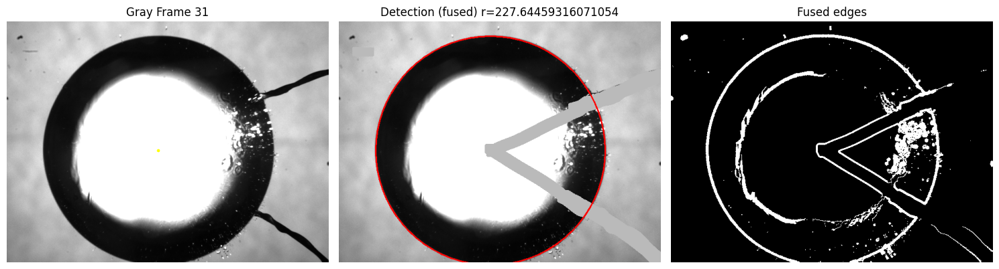

Frame 032: mode=fused, raw_r=230.0979959998919, center=(301,257), edge_pts=20989


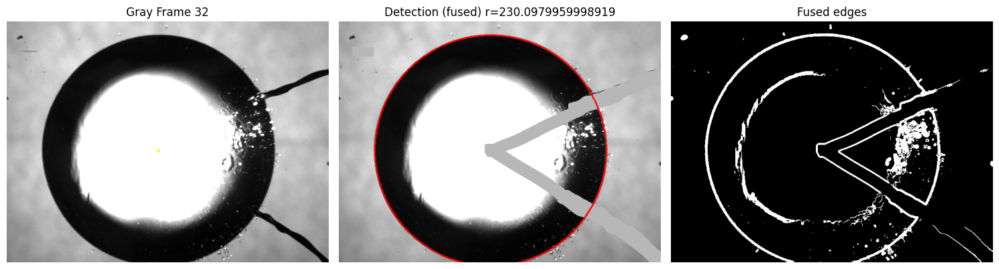

Frame 033: mode=fused, raw_r=232.55139883907327, center=(301,257), edge_pts=20297


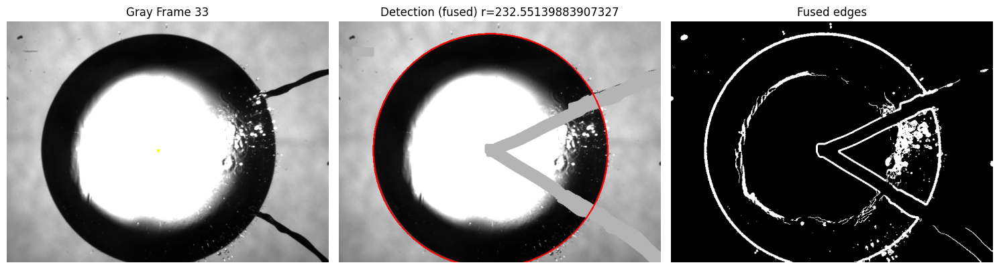

Frame 034: mode=fused, raw_r=235.00480167825464, center=(301,257), edge_pts=19234


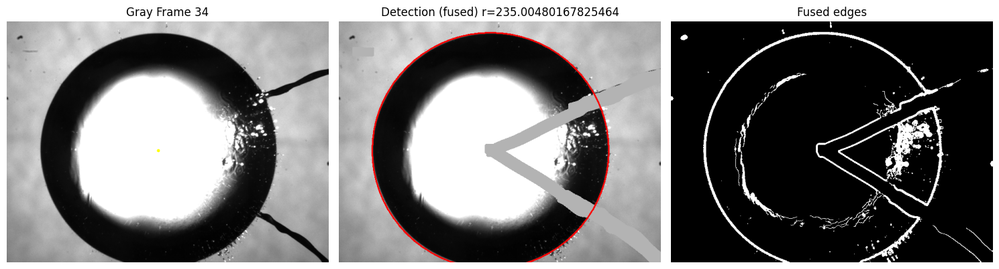

Frame 035: mode=fused, raw_r=234.71399585380954, center=(301,257), edge_pts=19619


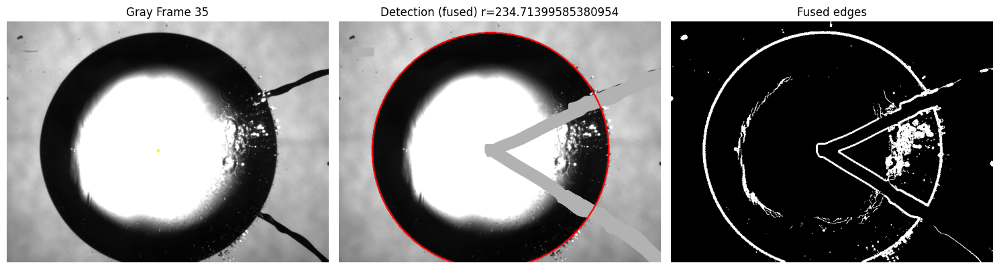

Frame 036: mode=fused, raw_r=237.458204517436, center=(301,257), edge_pts=20069


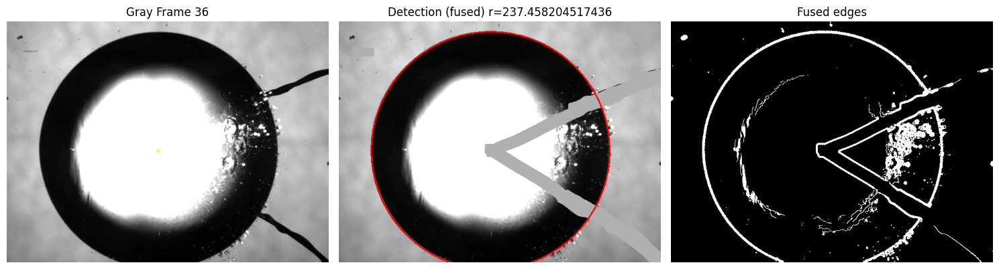

Frame 037: mode=fused, raw_r=237.1639974552781, center=(301,257), edge_pts=19460


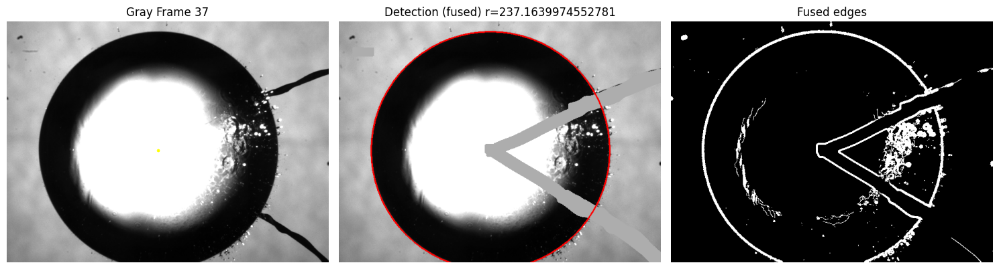

Frame 038: mode=fused, raw_r=237.1639974552781, center=(301,257), edge_pts=19668


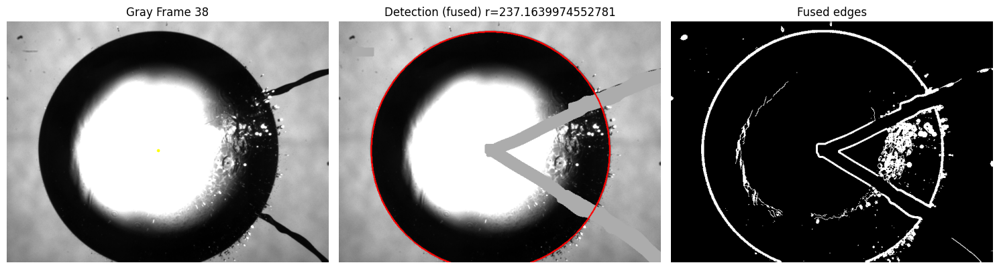

Frame 039: mode=fused, raw_r=239.61399905674665, center=(301,257), edge_pts=19655


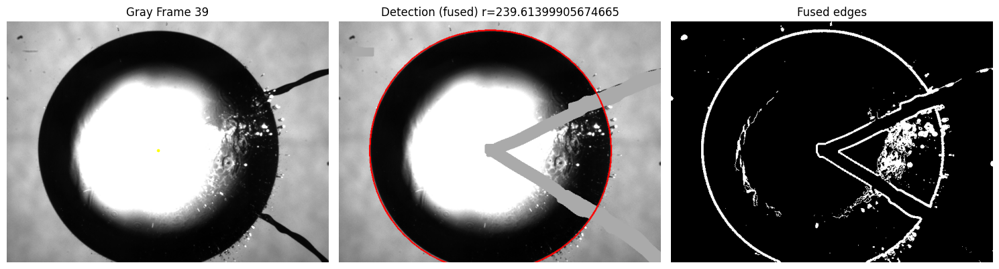

Frame 040: mode=fused, raw_r=239.61399905674665, center=(301,257), edge_pts=19265


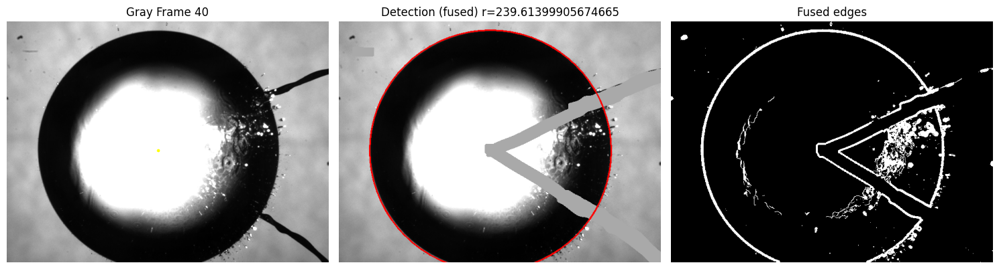

Frame 041: mode=fused, raw_r=239.61399905674665, center=(301,257), edge_pts=18985


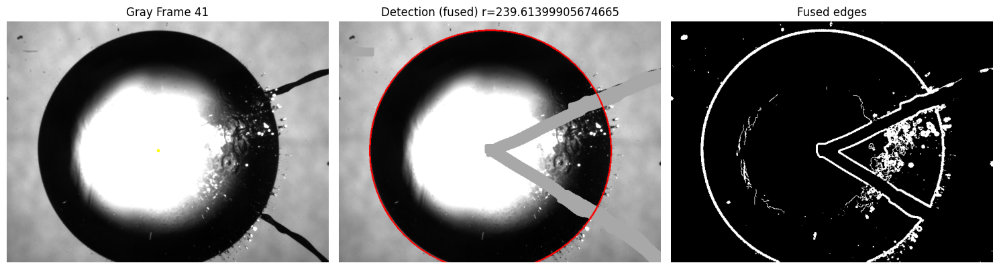

Frame 042: mode=fused, raw_r=239.53944457509473, center=(301,257), edge_pts=18812


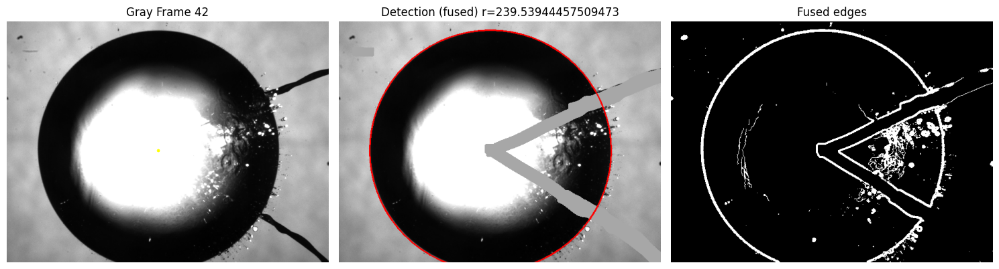

Frame 043: mode=fused, raw_r=239.53944457509473, center=(301,257), edge_pts=19054


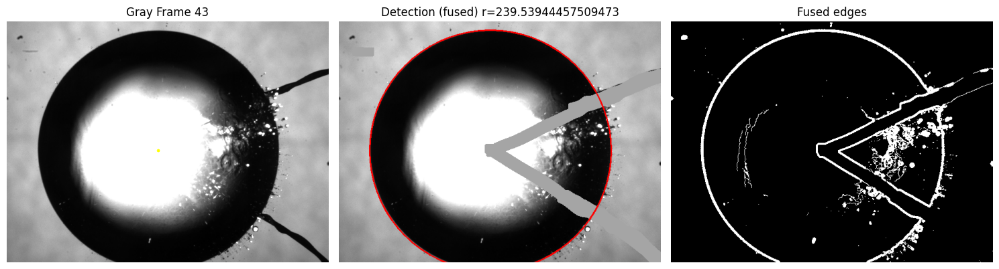

Frame 044: mode=fused, raw_r=239.61399905674665, center=(301,257), edge_pts=18223


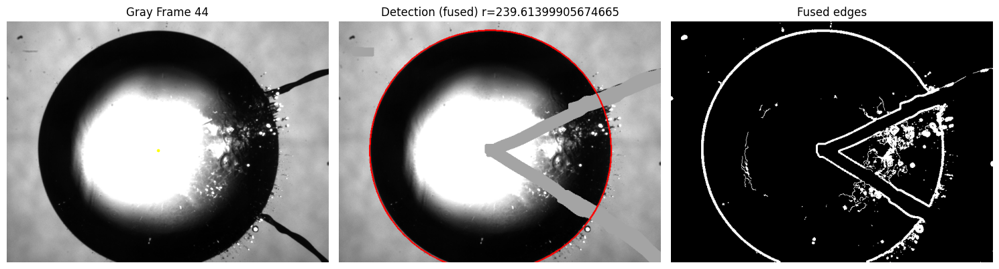

Frame 045: mode=fused, raw_r=237.1639974552781, center=(301,257), edge_pts=18544


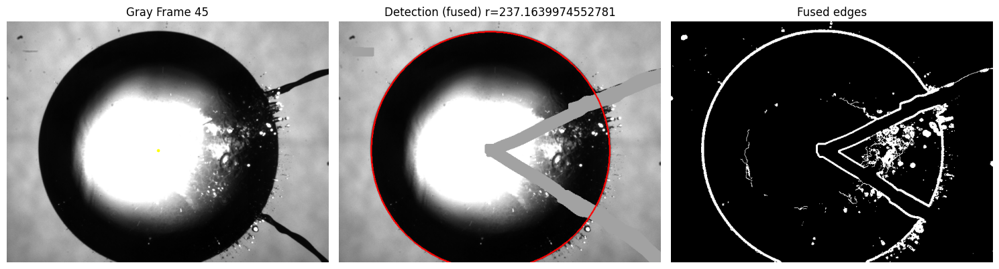

Frame 046: mode=fused, raw_r=237.23342751010816, center=(301,257), edge_pts=18397


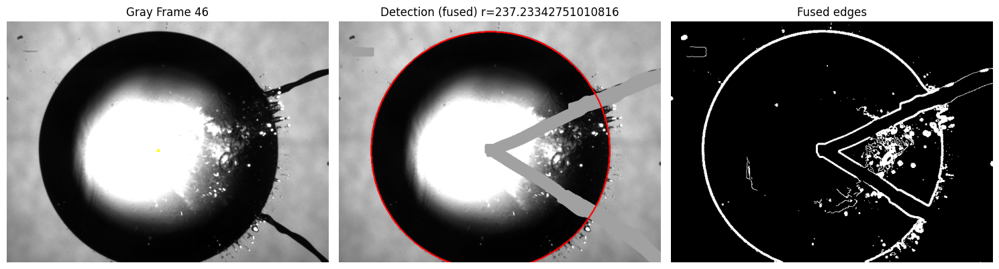

Frame 047: mode=fused, raw_r=236.6753243188964, center=(301,257), edge_pts=18513


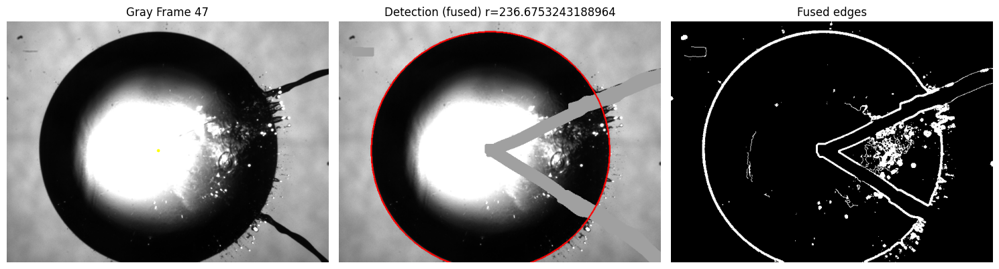

Frame 048: mode=fused, raw_r=236.6753243188964, center=(301,257), edge_pts=19455


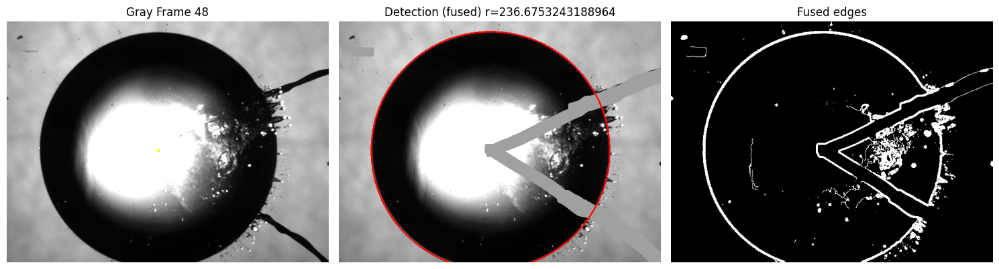

Frame 049: mode=fused, raw_r=234.83800865607583, center=(301,257), edge_pts=19654


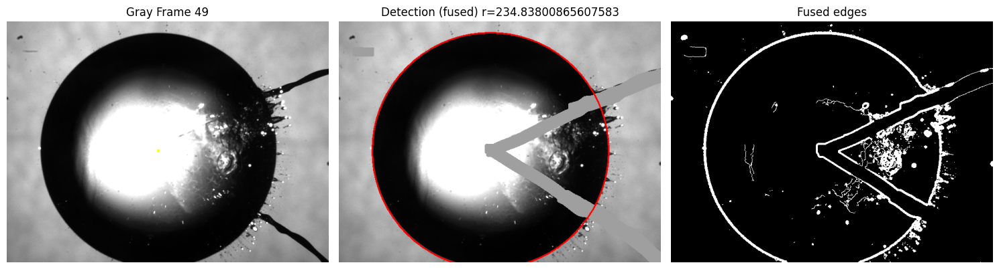

Frame 050: mode=fused, raw_r=232.26088559052457, center=(301,257), edge_pts=19513


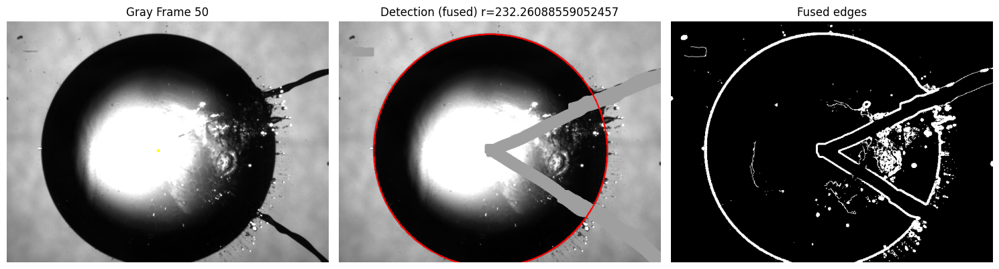

Frame 051: mode=fused, raw_r=232.00269524948982, center=(301,257), edge_pts=19378


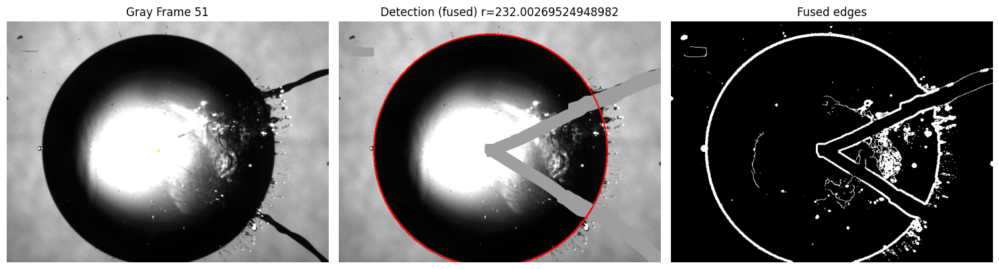

Frame 052: mode=fused, raw_r=230.0471709480112, center=(301,257), edge_pts=19223


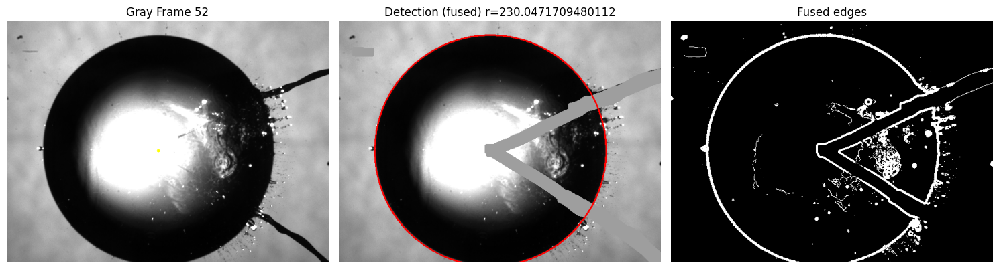

Frame 053: mode=fused, raw_r=227.36399104940386, center=(301,257), edge_pts=19852


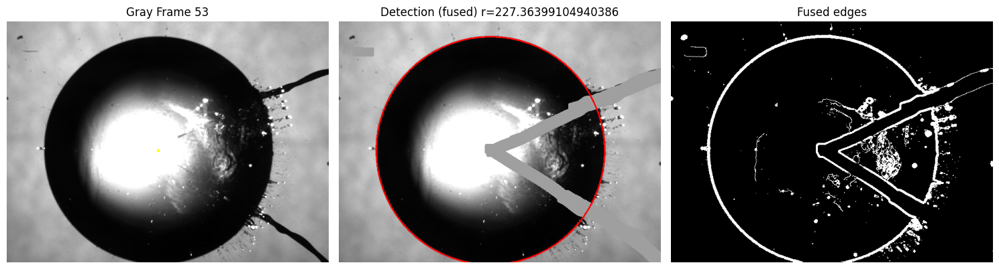

Frame 054: mode=fused, raw_r=225.25633323994657, center=(301,257), edge_pts=19996


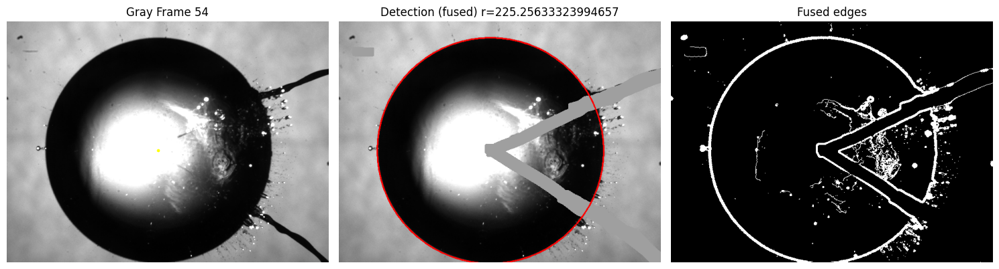

Frame 055: mode=fused, raw_r=222.86091438591424, center=(301,257), edge_pts=18951


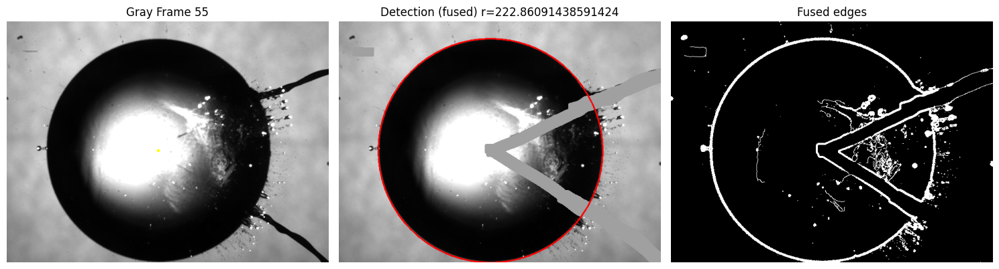

Frame 056: mode=fused, raw_r=220.0139862449982, center=(301,257), edge_pts=19376


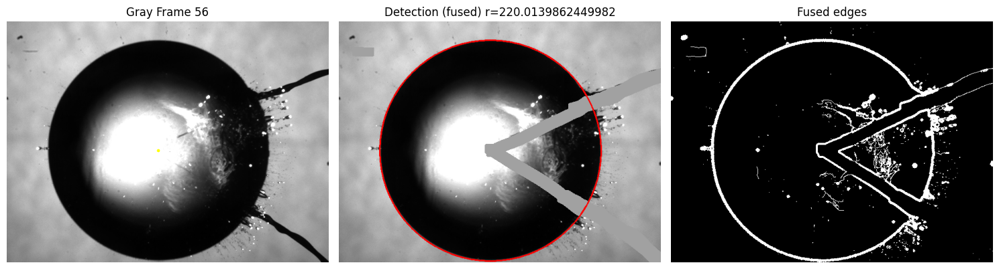

Frame 057: mode=segmentation, raw_r=213.82703290276467, center=(301,257), edge_pts=19327


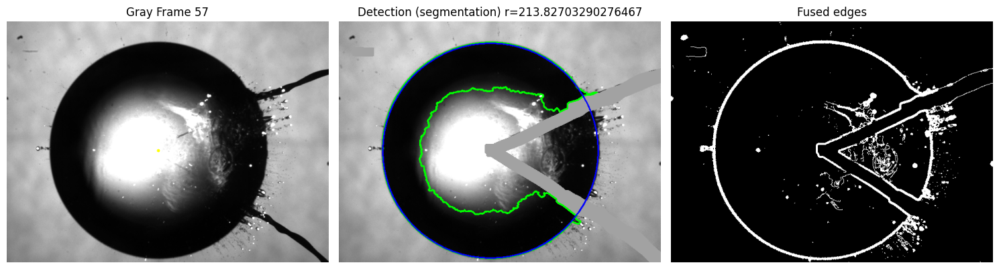

Frame 058: mode=segmentation, raw_r=207.99723158164926, center=(301,257), edge_pts=18933


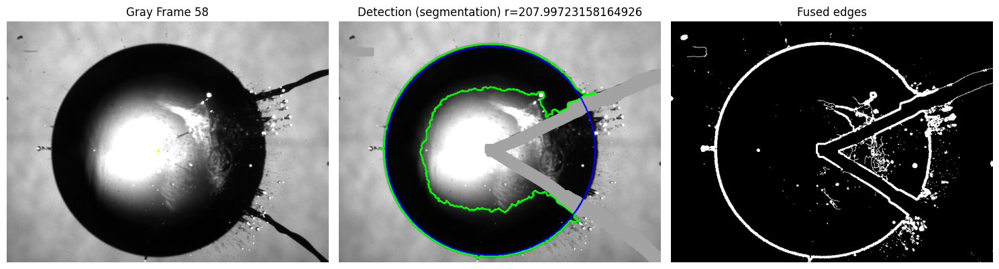

Frame 059: mode=segmentation, raw_r=207.06762180505189, center=(301,257), edge_pts=19057


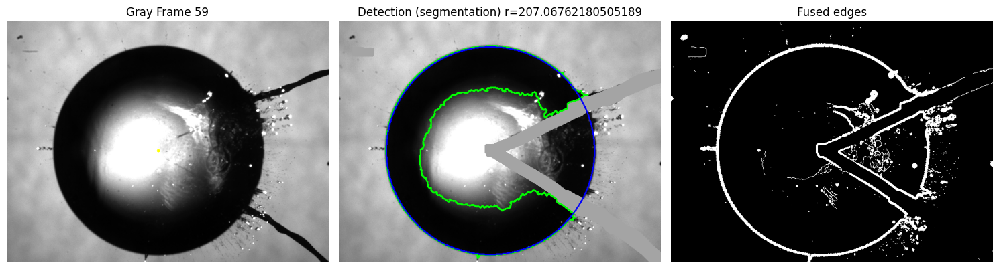

Frame 060: mode=segmentation, raw_r=203.15757431117353, center=(301,257), edge_pts=18718


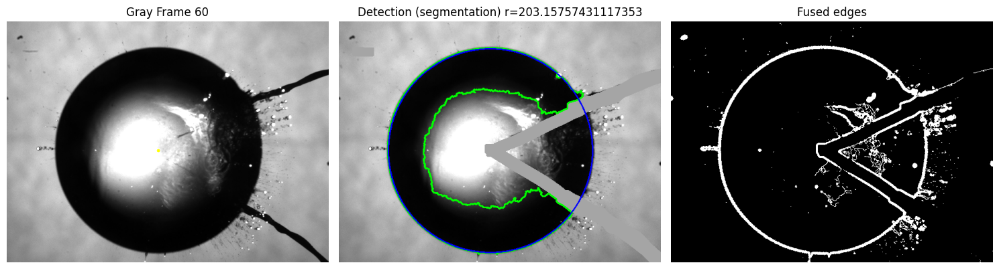

Frame 061: mode=segmentation, raw_r=198.8793604173143, center=(301,257), edge_pts=18425


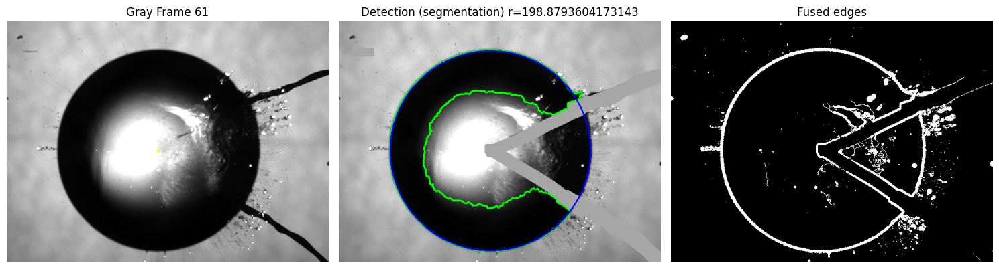

Frame 062: mode=segmentation, raw_r=194.36306233438492, center=(301,257), edge_pts=17998


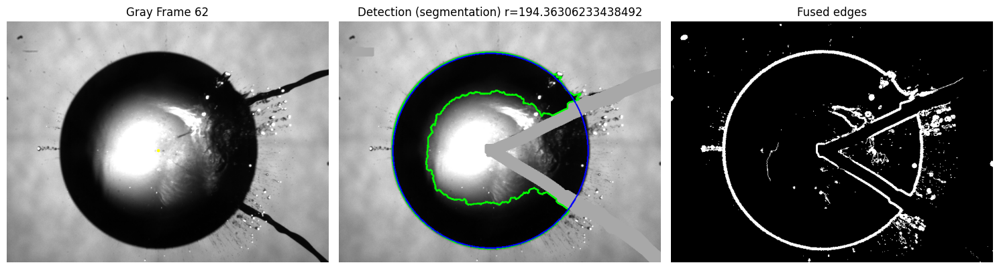

Frame 063: mode=segmentation, raw_r=189.40036936243865, center=(301,257), edge_pts=18396


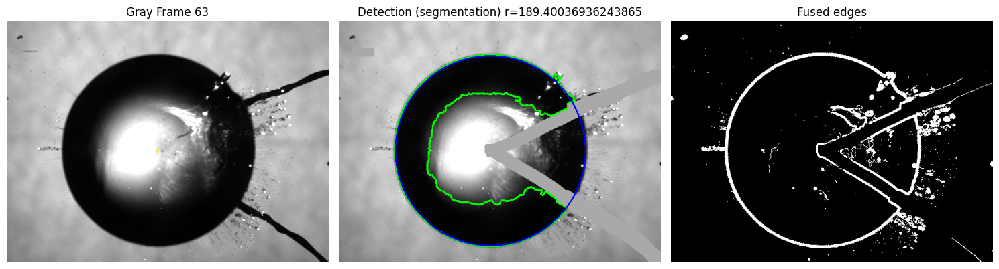

Frame 064: mode=segmentation, raw_r=184.26068490049633, center=(301,257), edge_pts=18248


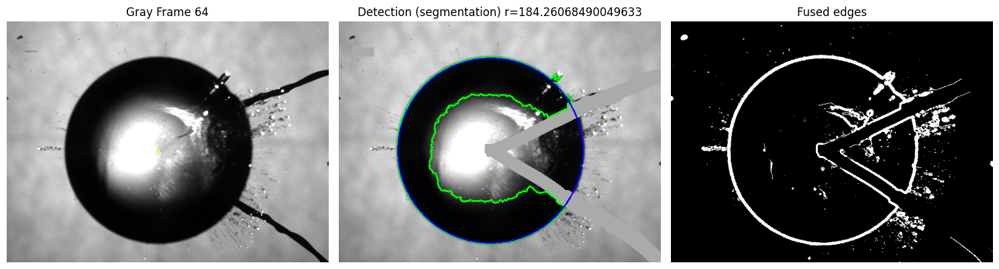

Frame 065: mode=segmentation, raw_r=178.13478043324386, center=(301,257), edge_pts=16909


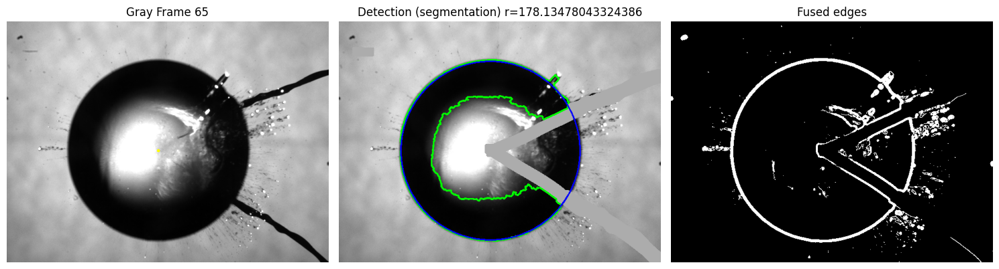

Frame 066: mode=segmentation, raw_r=172.06248834814747, center=(301,257), edge_pts=17702


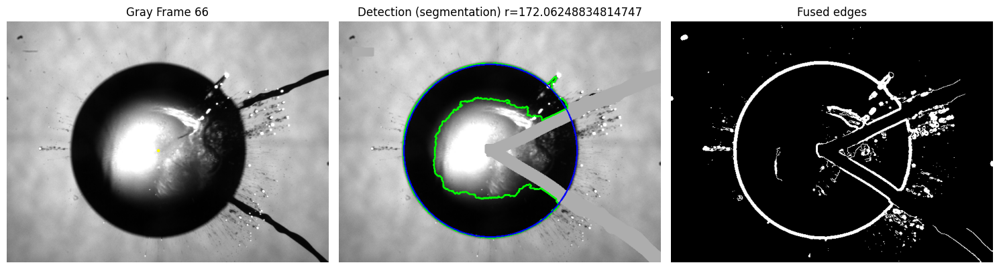

Frame 067: mode=segmentation, raw_r=165.00757552106734, center=(301,257), edge_pts=18372


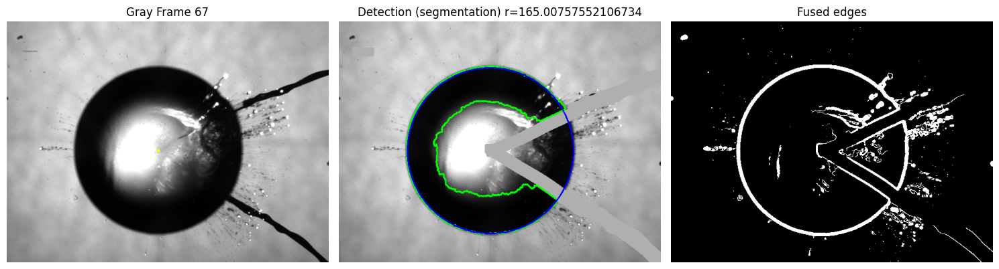

Frame 068: mode=segmentation, raw_r=157.4960316960399, center=(301,257), edge_pts=18276


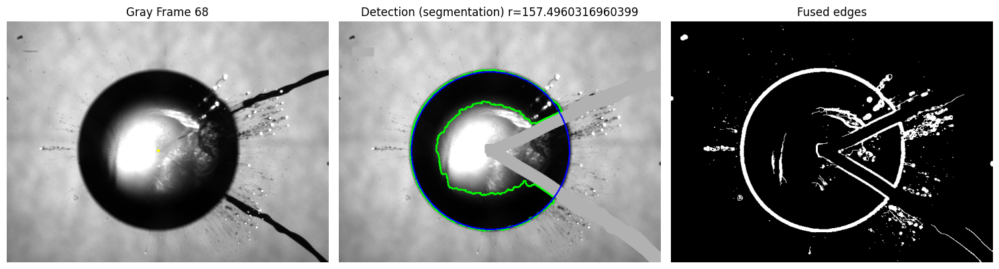

Frame 069: mode=segmentation, raw_r=148.95972610071487, center=(301,257), edge_pts=20005


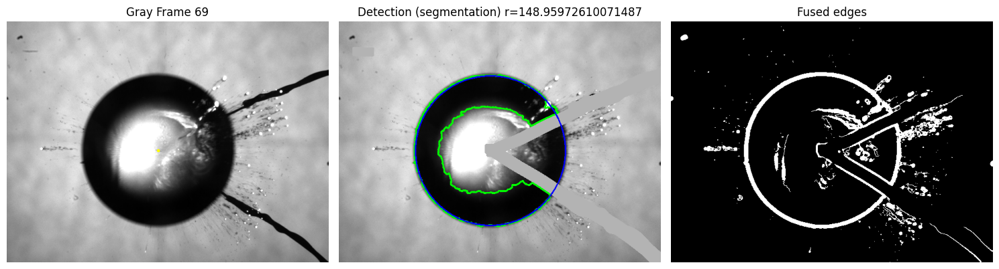

Frame 070: mode=segmentation, raw_r=139.9428454762872, center=(277,255), edge_pts=20909


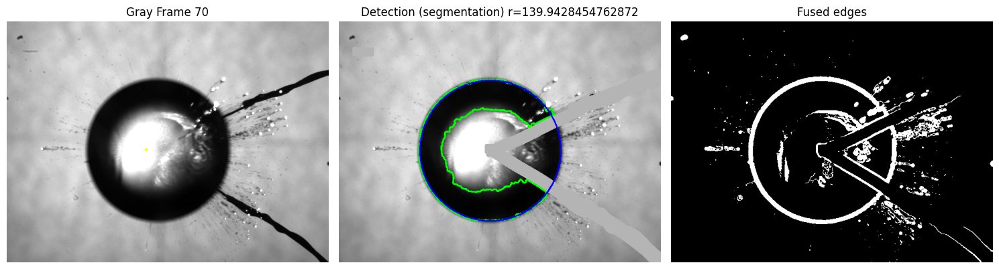

Frame 071: mode=segmentation, raw_r=114.10959644131601, center=(281,257), edge_pts=23895


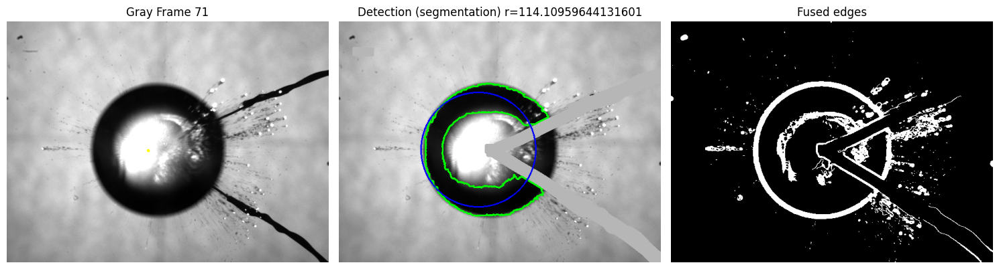

Frame 072: mode=segmentation, raw_r=107.5174404457249, center=(278,258), edge_pts=26075


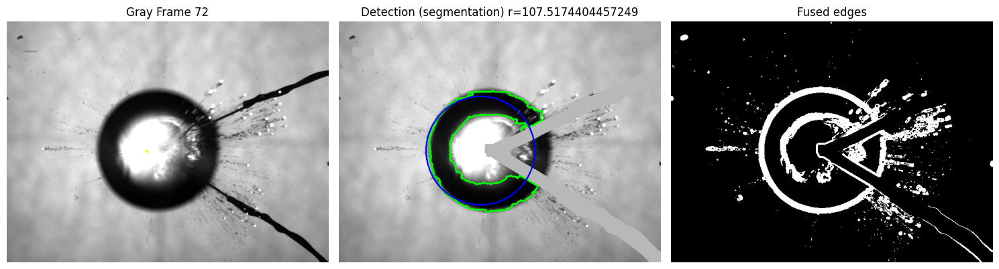

Frame 073: mode=segmentation, raw_r=92.84934033152847, center=(281,255), edge_pts=26251


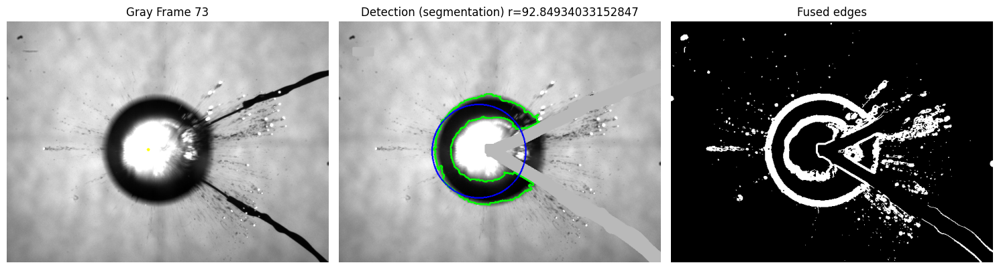

Frame 074: mode=segmentation, raw_r=88.64536084872124, center=(280,247), edge_pts=25686


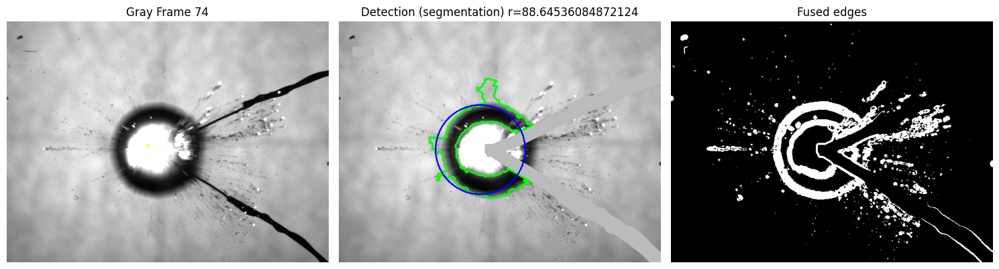

Frame 075: mode=fused, raw_r=55.09690756263159, center=(280,247), edge_pts=17123


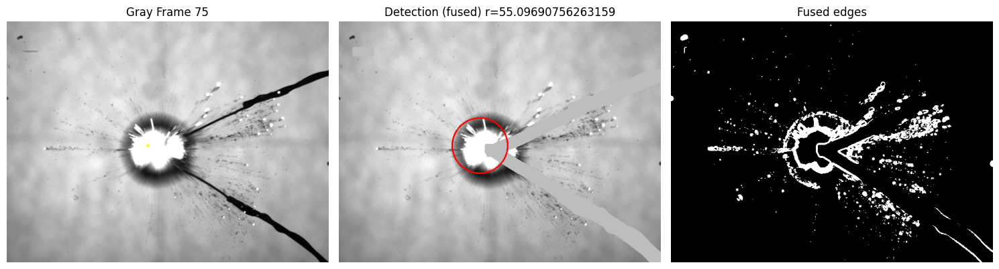

Frame 076: mode=fused, raw_r=42.10460071319447, center=(280,247), edge_pts=17259


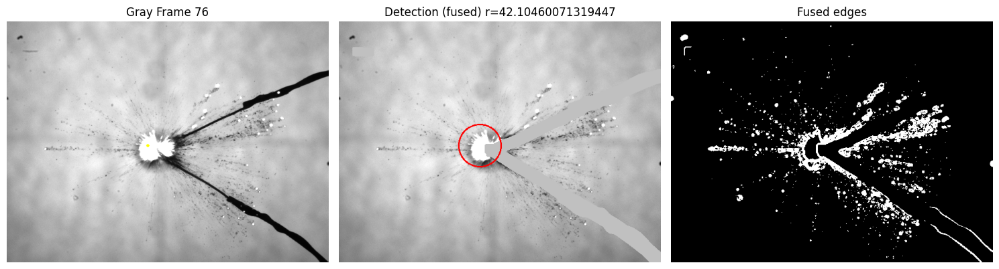

Frame 077: mode=segmentation, raw_r=47.09027137722783, center=(270,261), edge_pts=19466


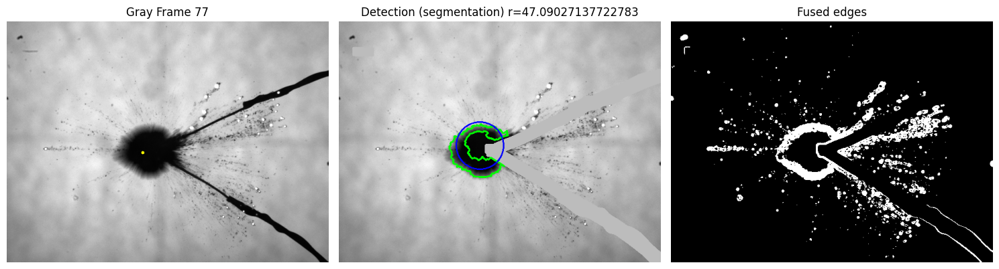

Frame 078: mode=segmentation, raw_r=60.67124524847005, center=(264,259), edge_pts=19083


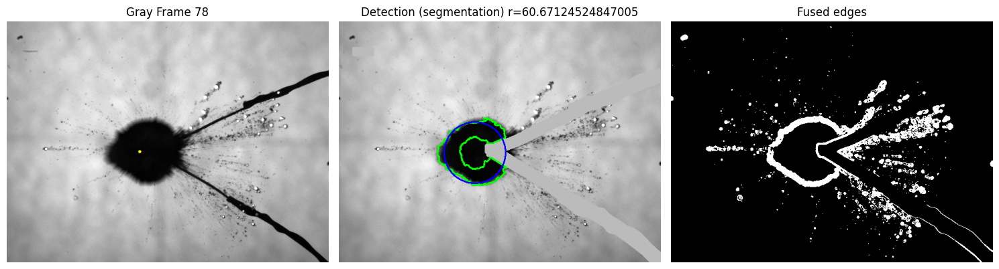

Frame 079: mode=segmentation, raw_r=70.3242230507179, center=(263,258), edge_pts=20847


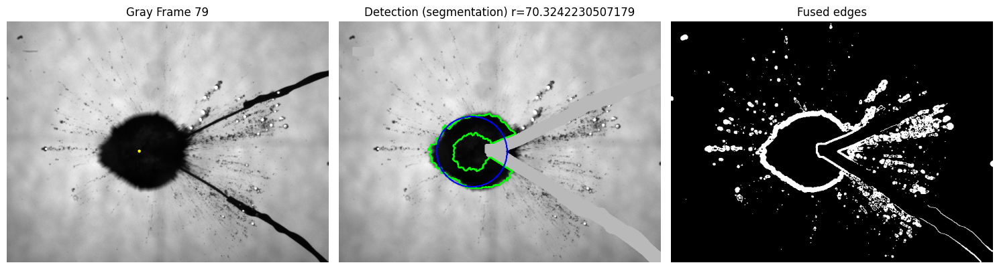

Frame 080: mode=segmentation, raw_r=79.39773296511683, center=(263,257), edge_pts=21591


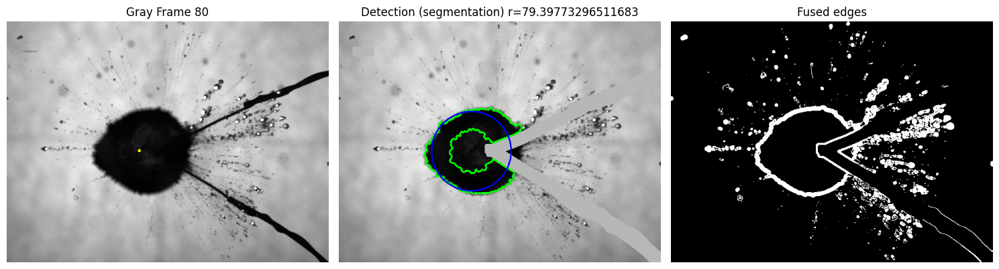

Frame 081: mode=segmentation, raw_r=87.86353054595519, center=(261,258), edge_pts=18310


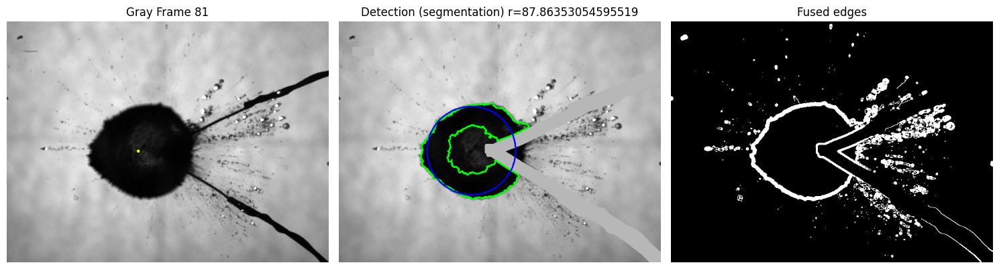

Frame 082: mode=segmentation, raw_r=93.39432435038853, center=(260,258), edge_pts=16735


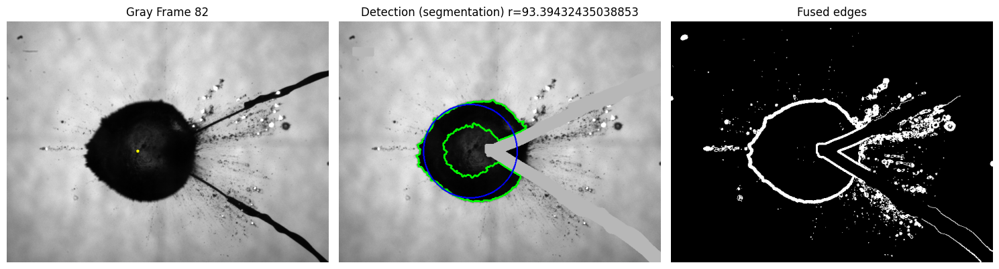

Frame 083: mode=segmentation, raw_r=98.23186852301538, center=(260,257), edge_pts=46362


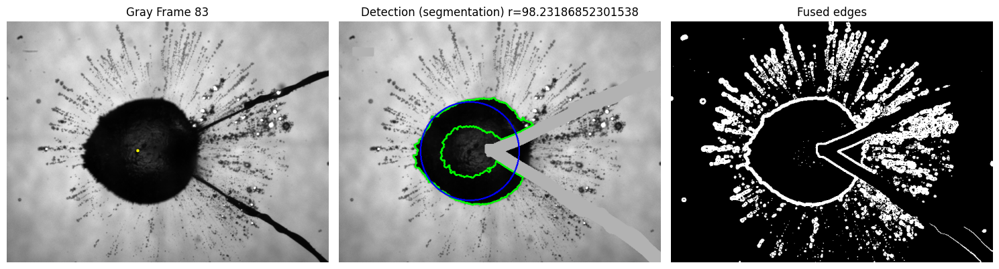

Frame 084: mode=segmentation, raw_r=103.24727599312246, center=(259,258), edge_pts=49974


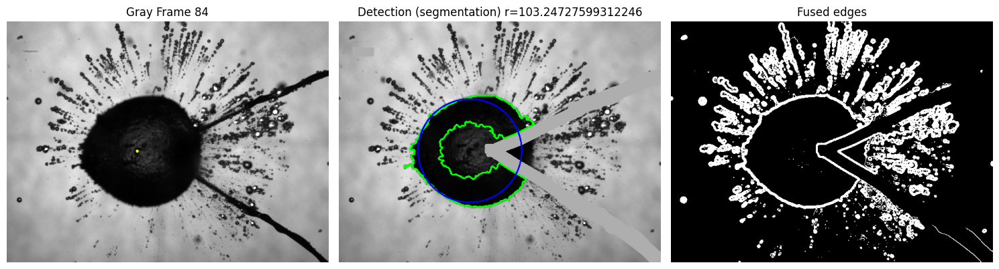

Frame 085: mode=segmentation, raw_r=107.00467279516349, center=(259,257), edge_pts=36510


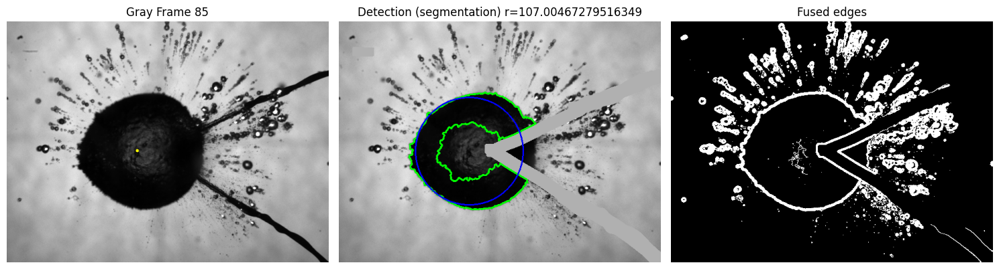

Frame 086: mode=segmentation, raw_r=111.37773420908402, center=(258,257), edge_pts=21661


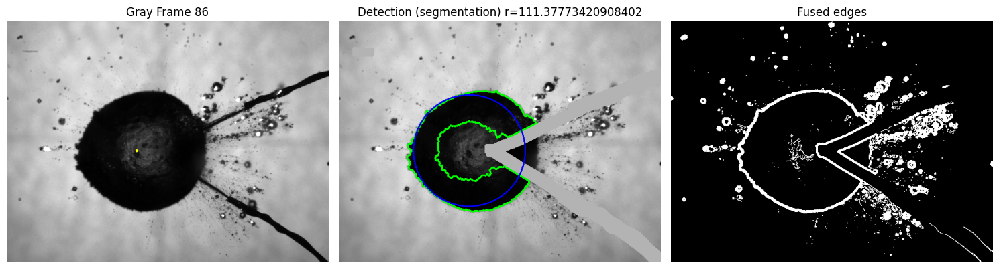

Frame 087: mode=segmentation, raw_r=113.52092241259074, center=(257,257), edge_pts=21817


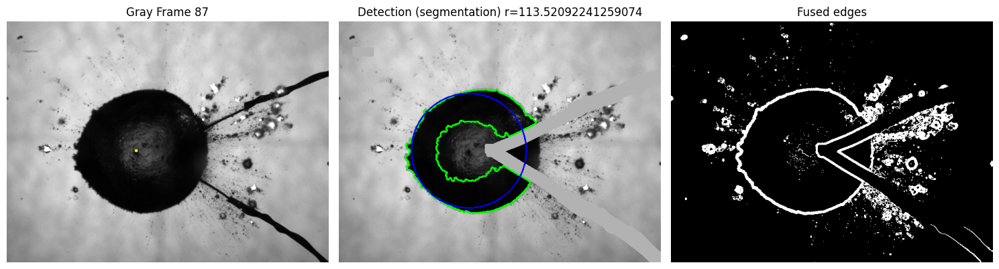

Frame 088: mode=segmentation, raw_r=116.26478239555377, center=(256,258), edge_pts=56688


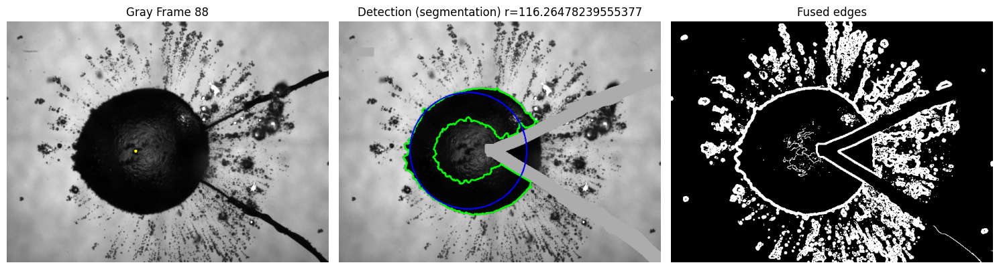

Frame 089: mode=segmentation, raw_r=118.00423721205946, center=(256,258), edge_pts=40026


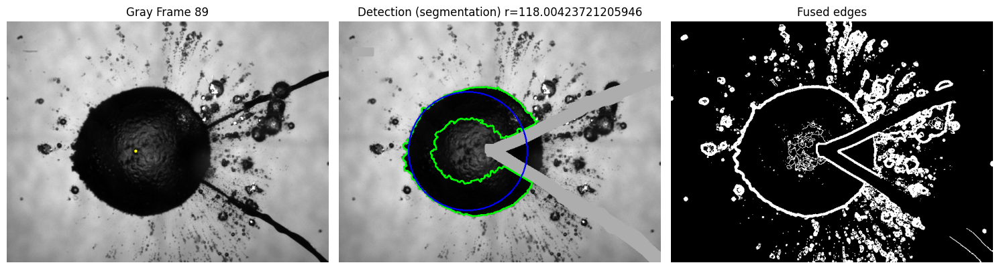

Frame 090: mode=segmentation, raw_r=120.00416659433121, center=(255,257), edge_pts=25192


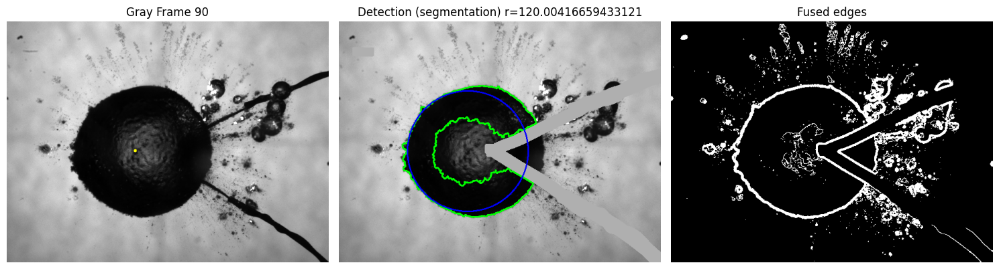

Frame 091: mode=segmentation, raw_r=119.44035699231719, center=(255,258), edge_pts=29668


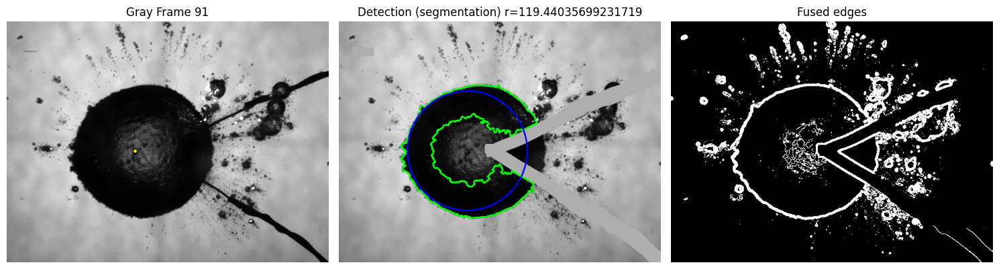

Frame 092: mode=segmentation, raw_r=122.88612614937456, center=(254,258), edge_pts=26748


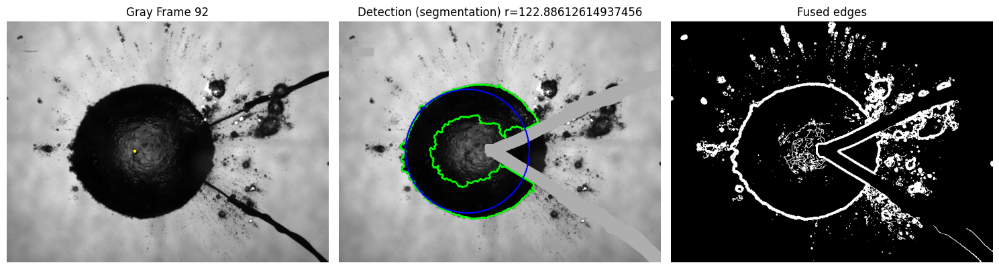

Frame 093: mode=segmentation, raw_r=123.44026761053482, center=(256,257), edge_pts=32581


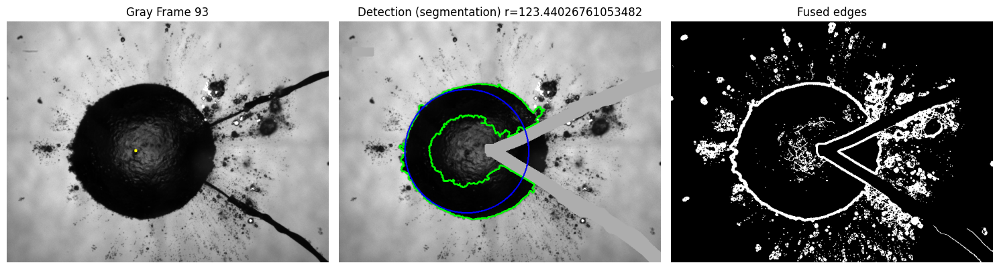

Frame 094: mode=segmentation, raw_r=124.53312810641975, center=(254,257), edge_pts=22388


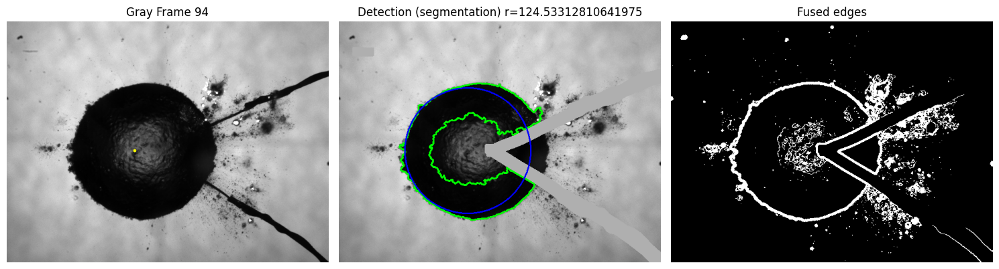

Frame 095: mode=segmentation, raw_r=124.46485433121177, center=(256,257), edge_pts=27090


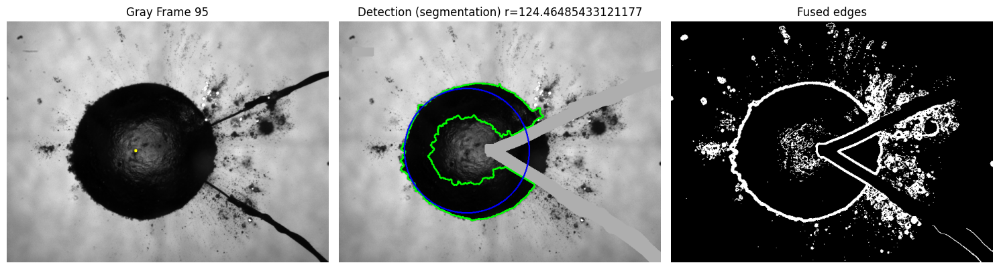

Frame 096: mode=segmentation, raw_r=125.78155667664477, center=(254,257), edge_pts=28199


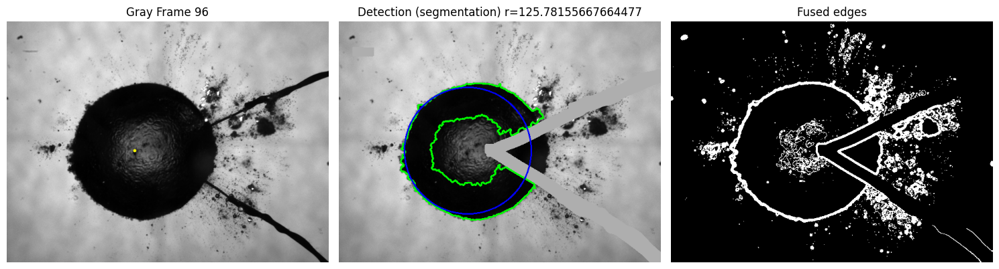

Frame 097: mode=segmentation, raw_r=124.00403219250575, center=(255,257), edge_pts=25505


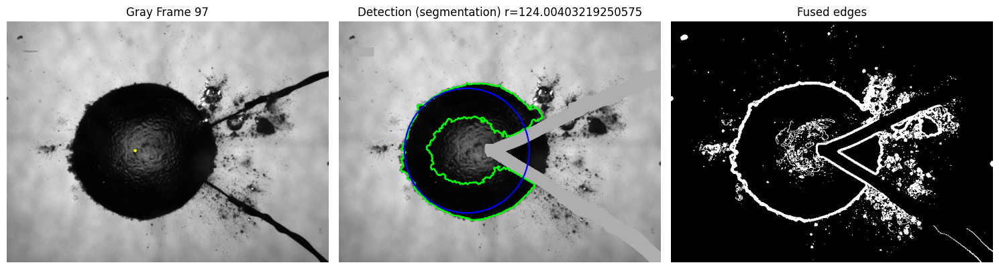

Frame 098: mode=segmentation, raw_r=125.09996003196804, center=(255,256), edge_pts=23081


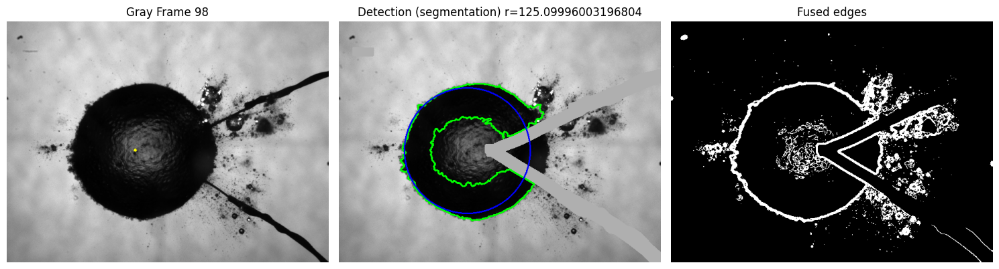

Frame 099: mode=segmentation, raw_r=122.2231084846047, center=(254,256), edge_pts=21727


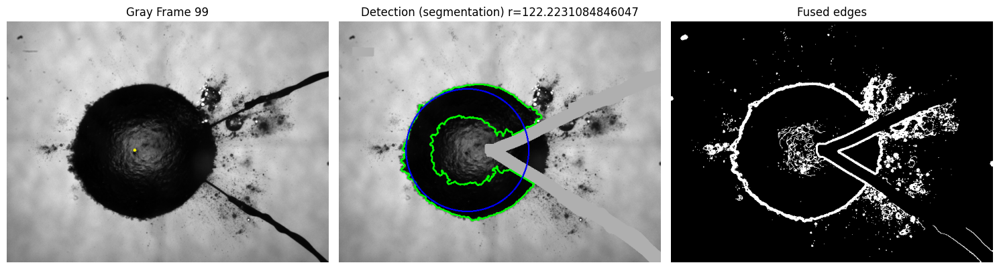

RP fit exception: Initial guess is outside of provided bounds


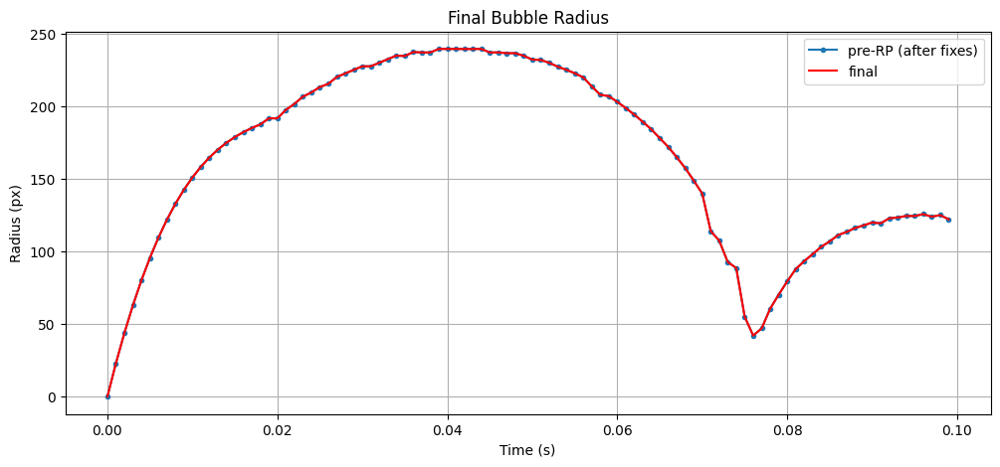

Saved results CSV to: /content/420_CU.zip_final_radius.csv
Pipeline complete.


In [35]:
# Cell 3: detection loop, postprocessing, RP init, RP tail fit, plotting

# ==========================================================
# Per-frame detection with limited center drift
# ==========================================================
final_radii = [np.nan] * n_frames
raw_seg = [np.nan] * n_frames
raw_fused = [np.nan] * n_frames
cx_curr, cy_curr = cx_fixed, cy_fixed
prev_r = None

for i, p in enumerate(image_paths):
    gray = load_gray_safe(p)
    gm = gray.copy()
    try:
        bg_val = int(np.median(gray[~mask_bin]))
    except Exception:
        bg_val = int(np.median(gray))
    gm[mask_bin] = bg_val

    r_val, vis, mode, centroid = detect_radius_combined(gm, cx_curr, cy_curr, prev_r)

    if mode == "segmentation" and centroid is not None:
        new_cx, new_cy = centroid
        dx = new_cx - cx_curr
        dy = new_cy - cy_curr
        if np.hypot(dx, dy) <= MAX_CENTER_DRIFT:
            cx_curr, cy_curr = new_cx, new_cy

    if mode == "segmentation":
        raw_seg[i] = r_val
    elif mode == "fused":
        raw_fused[i] = r_val

    if r_val is None or (isinstance(r_val, float) and np.isnan(r_val)):
        r_use = prev_r * FALLBACK_DECAY if (prev_r is not None and np.isfinite(prev_r)) else np.nan
    else:
        r_use = r_val

    final_radii[i] = r_use
    prev_r = r_use

    # Debug panels for visual inspection
    print(f"Frame {i:03d}: mode={mode}, raw_r={r_val}, center=({cx_curr},{cy_curr}), edge_pts={np.count_nonzero(fused_edges(gm))}")
    if DEBUG_DETECTION:
        plt.figure(figsize=(15,4))
        plt.subplot(1,3,1)
        gvis = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
        cv2.circle(gvis, (cx_curr, cy_curr), 3, (0,255,255), -1)
        plt.title(f"Gray Frame {i}"); plt.imshow(gvis[:,:,::-1]); plt.axis('off')
        plt.subplot(1,3,2)
        plt.title(f"Detection ({mode}) r={r_val}")
        if vis is None:
            plt.imshow(gray, cmap='gray')
        else:
            if vis.ndim == 2:
                plt.imshow(vis, cmap='gray')
            else:
                plt.imshow(vis[:,:,::-1])
        plt.axis('off')
        plt.subplot(1,3,3)
        fused_show = fused_edges(gm)
        plt.title("Fused edges"); plt.imshow(fused_show, cmap='gray'); plt.axis('off')
        plt.tight_layout(); plt.show()

# ==========================================================
# Post-processing
# ==========================================================
r = np.array(final_radii, dtype=float)

valid_mask = np.isfinite(r) & (r > MIN_BUBBLE_R)
if np.sum(valid_mask) < 5:
    print("Warning: less than 5 valid detections before cleaning")

# MAD outlier removal
if np.any(valid_mask):
    median_r = np.nanmedian(r[valid_mask])
    mad = np.nanmedian(np.abs(r[valid_mask] - median_r))
    z = np.abs(r - median_r) / (1.4826 * mad + 1e-8)
    r[z > RADIUS_OUTLIER_Z] = np.nan

# Interpolate to fill gaps (cubic)
valid_idx = np.where(np.isfinite(r))[0]
if len(valid_idx) >= 4:
    f_interp = interp1d(valid_idx, r[valid_idx], kind='cubic', fill_value='extrapolate')
    nan_idx = np.where(np.isnan(r))[0]
    for ii in nan_idx:
        r[ii] = float(f_interp(ii))

# ==========================================================
# RP-STYLE EARLY-FRAME INITIALIZATION (monotonic Hermite-like curve)
# (presented as RP initialization in the report)
# ==========================================================
N = EARLY_FRAMES if EARLY_FRAMES > 1 else 1
r[0] = 0.0
if EARLY_FRAMES < len(r):
    R1 = float(r[EARLY_FRAMES])
else:
    finite_idx = np.where(np.isfinite(r))[0]
    R1 = float(r[finite_idx[0]]) if finite_idx.size > 0 else 0.0

alpha = 2.5
m0 = alpha * R1
m1 = 0.2 * R1

def hermite_basis(t):
    t2 = t * t
    t3 = t2 * t
    h00 = 2*t3 - 3*t2 + 1
    h10 = t3 - 2*t2 + t
    h01 = -2*t3 + 3*t2
    h11 = t3 - t2
    return h00, h10, h01, h11

smooth = np.zeros(N)
for i in range(N):
    t = float(i) / float(N)
    h00, h10, h01, h11 = hermite_basis(t)
    val = h00*0.0 + h10*m0 + h01*R1 + h11*m1
    smooth[i] = val
smooth = np.maximum.accumulate(smooth)
smooth[smooth < 0] = 0.0
r[:N] = smooth
r[N-1] = R1

# ==========================================================
# Spike detection & correction
# ==========================================================
dr = np.diff(r)
spike_positions = np.where(np.abs(dr) > SPIKE_JUMP_THRESH)[0]
for sp in spike_positions:
    i_spike = sp + 1
    left = r[sp] if sp >= 0 else np.nan
    right = r[sp+2] if (sp+2) < len(r) else np.nan
    if SPIKE_REPLACE_WITH == "interp" and len(valid_idx) >= 4:
        if not np.isnan(left) and not np.isnan(right):
            r[i_spike] = 0.5*(left + right)
        elif not np.isnan(left):
            r[i_spike] = left
        elif not np.isnan(right):
            r[i_spike] = right
    elif SPIKE_REPLACE_WITH == "median":
        r[i_spike] = np.nanmedian(r)
    else:
        if not np.isnan(left):
            r[i_spike] = left
        elif not np.isnan(right):
            r[i_spike] = right

r_preRP = r.copy()

# ==========================================================
# Optional RP tail fitting (robust)
# ==========================================================
rho = 1000.0; mu = 0.001; sigma = 0.072; pv = 2300.0; p_inf = 1e5

def rp_ode_local(t, y, pg0, k, R0):
    R, dR = y
    R = max(R, 1e-9)
    pg = pg0 * 1e5 * (R0 * 1e-6 / R)**(3*k)
    rhs = (pg + pv - p_inf - 2*sigma/R - 4*mu*dR/R) / rho
    return [dR, (rhs - 1.5 * dR * dR) / R]

def rp_model_local(t_fit, params, t_start):
    pg0,k,R0 = params
    y0 = [R0 * 1e-6, 0.0]
    sol = solve_ivp(rp_ode_local, [t_start, t_fit[-1]], y0,
                    args=(pg0,k,R0), method='BDF', rtol=1e-5, atol=1e-8, dense_output=True)
    r_model_m = sol.sol(t_fit)[0]
    return r_model_m / 1e-6 * PX_TO_UM

if USE_RP_FIT and RP_FIT_START_FRAME < n_frames:
    start = RP_FIT_START_FRAME
    mask_fit = np.arange(start, n_frames)
    r_fit = r[mask_fit]
    t_fit = t_frames[mask_fit]
    if np.any(np.isfinite(r_fit)):
        med_local = np.nanmedian(r_fit)
        mad_local = np.nanmedian(np.abs(r_fit - med_local))
        local_z = np.abs(r_fit - med_local) / (1.4826*mad_local + 1e-8)
        outmask = local_z > RP_OUTLIER_THRESH
        clean_mask = ~outmask & np.isfinite(r_fit)
        if np.sum(clean_mask) >= 5:
            r_data = r_fit[clean_mask]
            t_data = t_fit[clean_mask]
            R0_guess = r_data[0] / PX_TO_UM
            p0 = [1.0, 1.0, R0_guess]
            bounds = ([0.1, 0.8, 0.1], [10.0, 1.4, 10.0])
            try:
                res = least_squares(lambda params: (r_data - rp_model_local(t_data, params, t_frames[start])),
                                    p0, bounds=bounds, loss='soft_l1')
                if res.success:
                    print("RP fit succeeded (tail correction). Params:", res.x)
                    r_model_tail = rp_model_local(t_fit, res.x, t_frames[start])
                    r[mask_fit][outmask] = r_model_tail[outmask]
                else:
                    print("RP fit did not converge - keeping pre-RP values.")
            except Exception as e:
                print("RP fit exception:", e)
        else:
            print("Not enough clean points for RP fit; skipping RP.")

r_smooth = r.copy()

# ==========================================================
# Final plot & CSV
# ==========================================================
plt.figure(figsize=(12,5))
plt.plot(t_frames, r_preRP, marker='.', label='pre-RP (after fixes)')
plt.plot(t_frames, r_smooth, 'r-', label='final')
plt.grid(True)
plt.xlabel("Time (s)")
plt.ylabel("Radius (px)")
plt.title("Final Bubble Radius")
plt.legend()
plt.show()

csv_path = f"/content/{os.path.basename(zip_path)}_final_radius.csv"
df = pd.DataFrame({"Frame": np.arange(n_frames), "Time_s": t_frames, "Radius_px": r_smooth})
df.to_csv(csv_path, index=False)
print("Saved results CSV to:", csv_path)
print("Pipeline complete.")
